<a href="https://colab.research.google.com/github/ChriRRojas/Parkinson-Detection-with-CNN-and-GANs/blob/main/Modelo_PEP_2_7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Importar las librerías necesarias
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.layers import Dense, Reshape, Flatten, BatchNormalization, LeakyReLU, Conv2DTranspose, Conv2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image


2024-11-07 15:52:38.453468: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:

# Definir rutas de las carpetas con las imágenes de Parkinson y Control
pd_path = "/home/crakerool/Parkinson UCN/Parkinson/trainDatasets/PD"
control_path = "/home/crakerool/Parkinson UCN/Parkinson/trainDatasets/CONTROL"
gan_generated_pd_path = "/home/crakerool/Parkinson UCN/Parkinson/ganGenerated/PD"
gan_generated_control_path = "/home/crakerool/Parkinson UCN/Parkinson/ganGenerated/CONTROL"


In [ ]:
# Crear carpetas para almacenar las imágenes generadas por el GAN, si no existen
os.makedirs(gan_generated_pd_path, exist_ok=True)
os.makedirs(gan_generated_control_path, exist_ok=True)


In [ ]:

# Cargar las imágenes de las carpetas y convertirlas a matrices numpy
def load_images_from_folder(folder_path, image_size=(64, 64)):
    images = []
    for filename in os.listdir(folder_path):
        if filename.endswith(".png"):
            img_path = os.path.join(folder_path, filename)
            img = Image.open(img_path).convert('RGB')
            img = img.resize(image_size)
            images.append(np.array(img))
    return np.array(images)


In [ ]:
# Cargar las imágenes de Parkinson y normalizarlas
pd_images = load_images_from_folder(pd_path)
pd_images = (pd_images - 127.5) / 127.5  # Normalizar las imágenes al rango [-1, 1]


In [ ]:
# Definir parámetros del dataset de Parkinson
BUFFER_SIZE_PD = pd_images.shape[0]
BATCH_SIZE = 32

In [ ]:
# Crear dataset de TensorFlow para Parkinson
dataset_pd = tf.data.Dataset.from_tensor_slices(pd_images).shuffle(BUFFER_SIZE_PD).batch(BATCH_SIZE)

# Cargar las imágenes de Control y normalizarlas
control_images = load_images_from_folder(control_path)
control_images = (control_images - 127.5) / 127.5  # Normalizar las imágenes al rango [-1, 1]

# Definir parámetros del dataset de Control
BUFFER_SIZE_CONTROL = control_images.shape[0]

# Crear dataset de TensorFlow para Control
dataset_control = tf.data.Dataset.from_tensor_slices(control_images).shuffle(BUFFER_SIZE_CONTROL).batch(BATCH_SIZE)


2024-11-07 15:52:45.731082: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.


In [ ]:

# Definir el generador del GAN
def build_generator():
    model = Sequential()
    model.add(Dense(8 * 8 * 256, use_bias=False, input_shape=(100,)))
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Reshape((8, 8, 256)))
    model.add(Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    return model

# Definir el discriminador del GAN
def build_discriminator():
    model = Sequential()
    model.add(Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[64, 64, 3]))
    model.add(LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(Flatten())
    model.add(Dense(1))
    return model

# Crear los modelos del generador y el discriminador
generator = build_generator()
discriminator = build_discriminator()


In [ ]:
# Definir la función de pérdida y los optimizadores
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# Definir los optimizadores del generador y el discriminador
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

# Definir el entrenamiento del GAN
EPOCHS = 100
NOISE_DIM = 100
NUM_EXAMPLES_TO_GENERATE = 5

seed = tf.random.normal([NUM_EXAMPLES_TO_GENERATE, NOISE_DIM])

# Funciones para entrenar el GAN
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

def train(dataset, epochs, save_path):
    for epoch in range(epochs):
        for image_batch in dataset:
            train_step(image_batch)

        # Generar y guardar algunas imágenes al final de cada época
        generate_and_save_images(generator, epoch + 1, seed, save_path)
        print(f"Epoch {epoch + 1}/{epochs} completed")

        # Visualizar algunas imágenes generadas durante el entrenamiento
        visualize_generated_images(generator, seed)


# Funciones para generar y guardar imágenes
def generate_and_save_images(model, epoch, test_input, save_path):
    predictions = model(test_input, training=False)

    for i in range(predictions.shape[0]):
        img = (predictions[i] + 1) / 2  # Desnormalizar al rango [0, 1]
        img = tf.cast(img * 255, tf.uint8).numpy()  # Convertir a uint8
        img = Image.fromarray(img)
        img.save(os.path.join(save_path, f"gan_generated_epoch_{epoch}_img_{i}.png"))

# Función para visualizar imágenes generadas durante el entrenamiento
def visualize_generated_images(model, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10, 10))
    for i in range(predictions.shape[0]):
        plt.subplot(1, NUM_EXAMPLES_TO_GENERATE, i+1)
        plt.imshow((predictions[i] + 1) / 2)
        plt.axis('off')
    plt.show()

Entrenando GAN con imágenes de Parkinson...


2024-11-07 15:52:51.808349: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [4530,64,64,3]
	 [[{{node Placeholder/_0}}]]
2024-11-07 15:52:51.808552: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [4530,64,64,3]
	 [[{{node Placeholder/_0}}]]


Epoch 1/100 completed


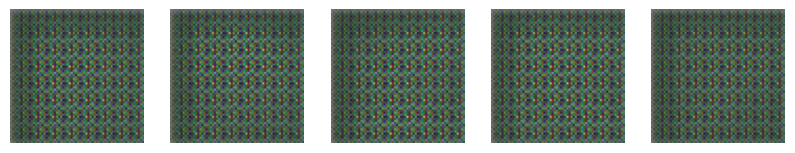

Epoch 2/100 completed


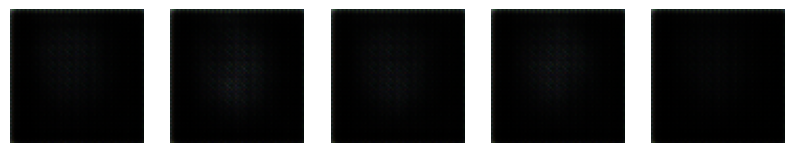

Epoch 3/100 completed


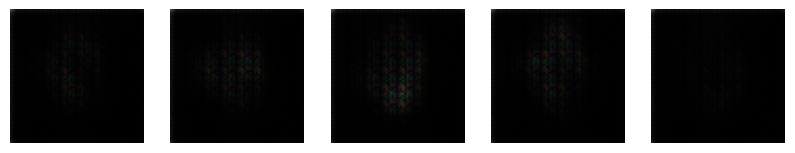

Epoch 4/100 completed


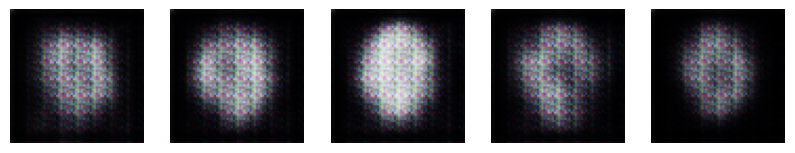

Epoch 5/100 completed


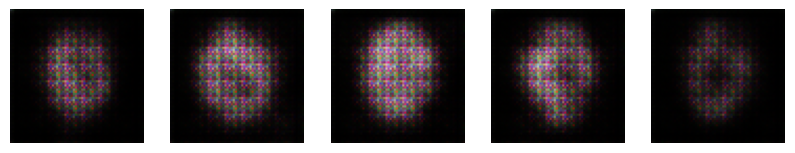

Epoch 6/100 completed


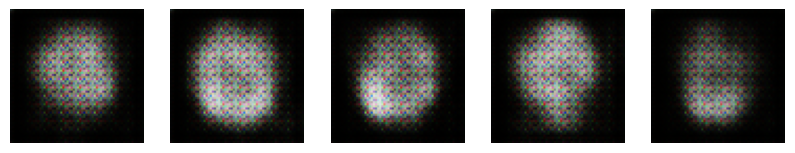

Epoch 7/100 completed


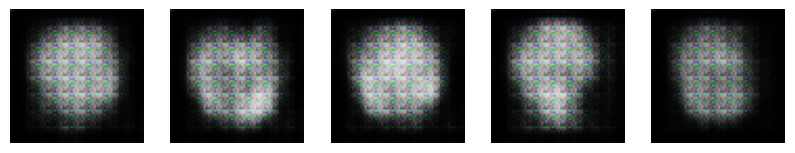

Epoch 8/100 completed


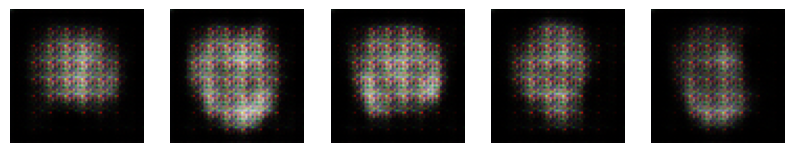

Epoch 9/100 completed


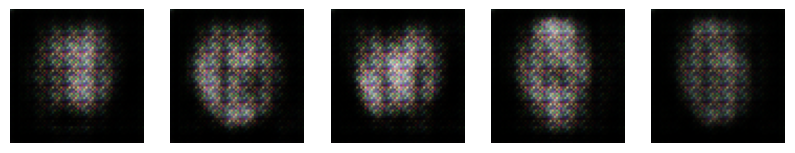

Epoch 10/100 completed


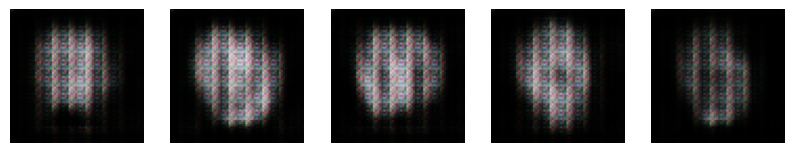

Epoch 11/100 completed


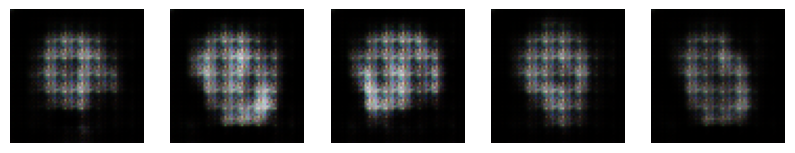

Epoch 12/100 completed


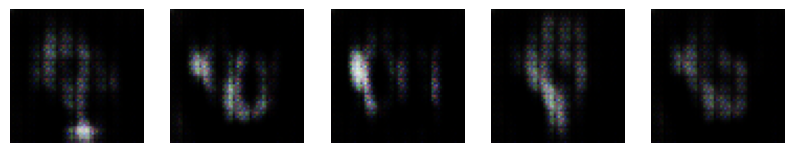

Epoch 13/100 completed


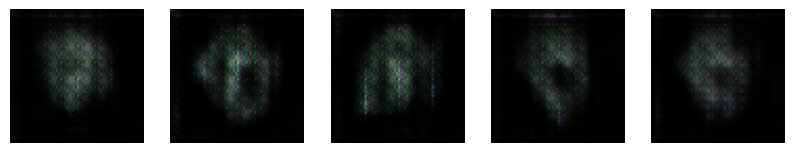

Epoch 14/100 completed


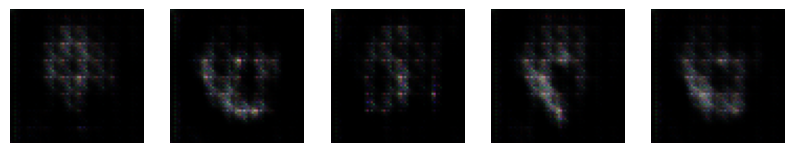

Epoch 15/100 completed


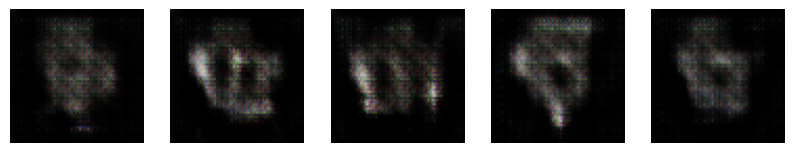

Epoch 16/100 completed


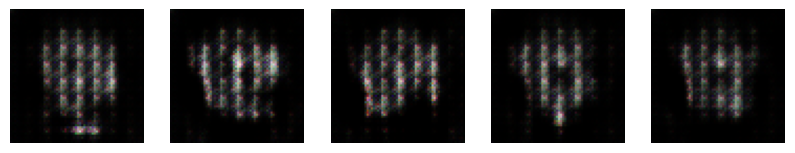

Epoch 17/100 completed


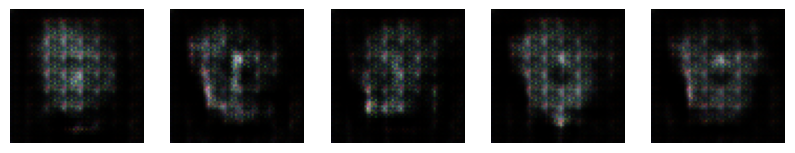

Epoch 18/100 completed


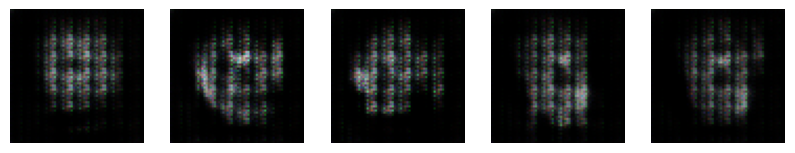

Epoch 19/100 completed


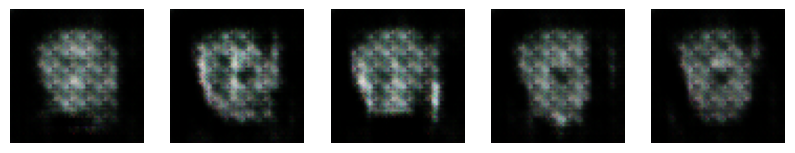

Epoch 20/100 completed


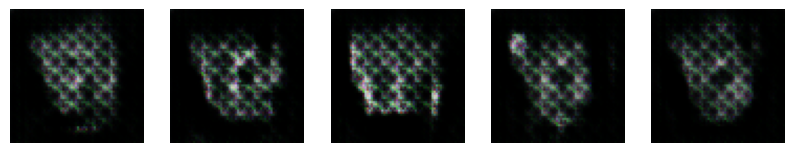

Epoch 21/100 completed


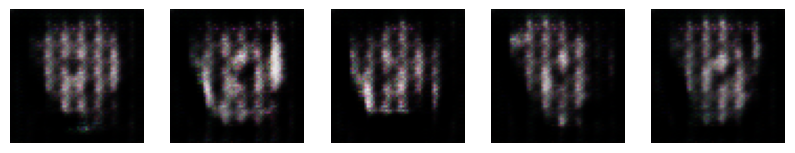

Epoch 22/100 completed


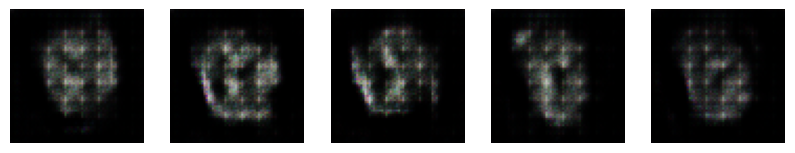

Epoch 23/100 completed


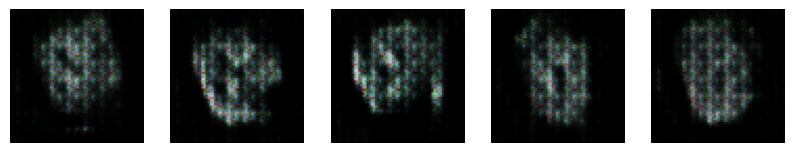

Epoch 24/100 completed


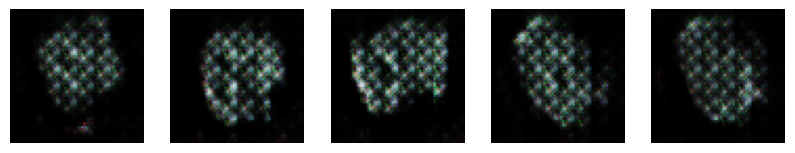

Epoch 25/100 completed


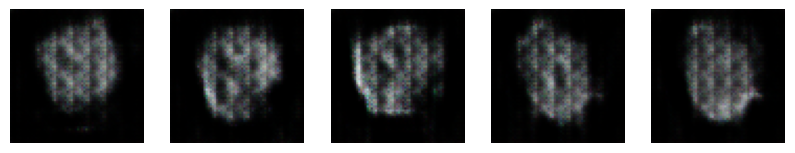

Epoch 26/100 completed


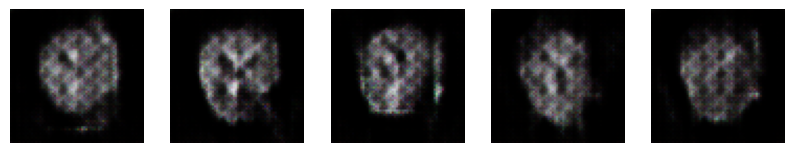

Epoch 27/100 completed


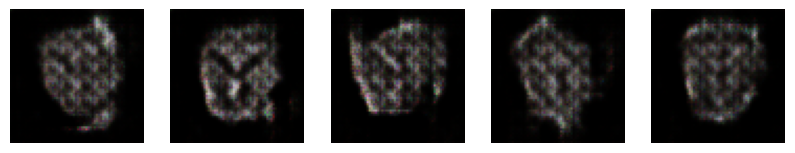

Epoch 28/100 completed


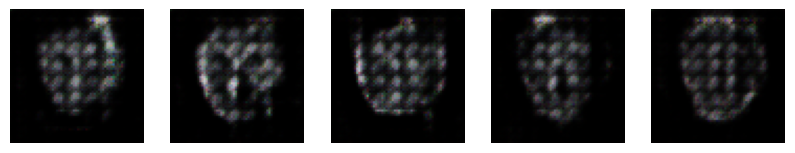

Epoch 29/100 completed


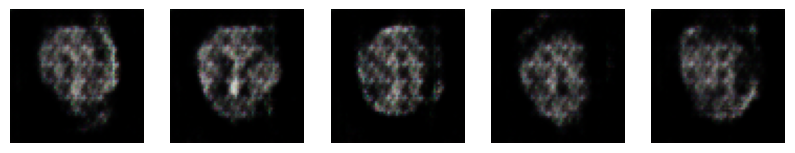

Epoch 30/100 completed


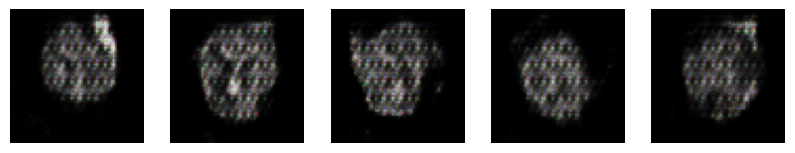

Epoch 31/100 completed


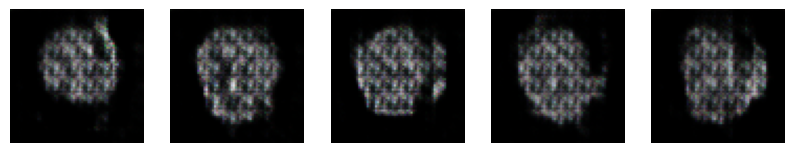

Epoch 32/100 completed


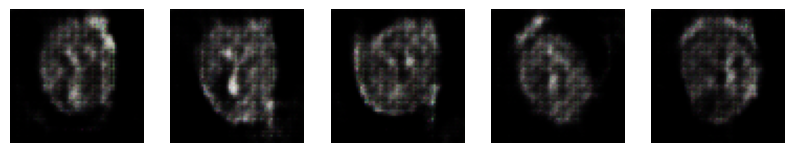

Epoch 33/100 completed


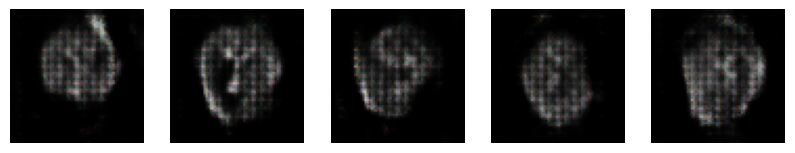

Epoch 34/100 completed


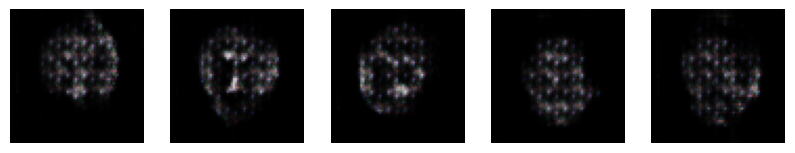

Epoch 35/100 completed


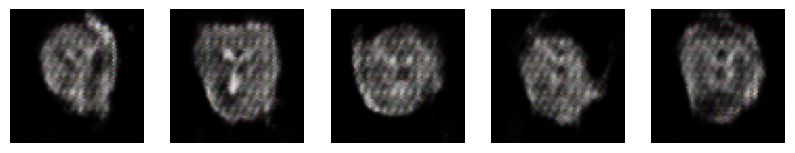

Epoch 36/100 completed


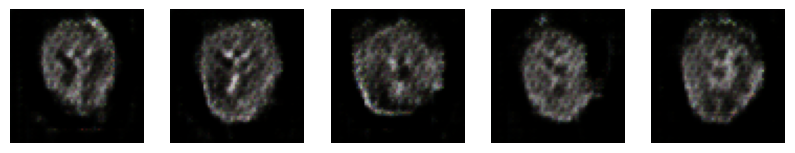

Epoch 37/100 completed


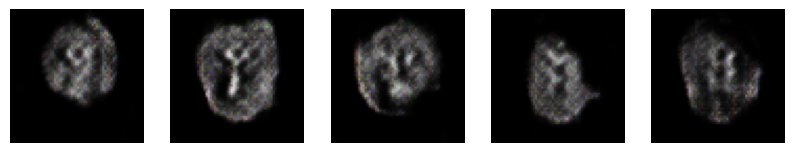

Epoch 38/100 completed


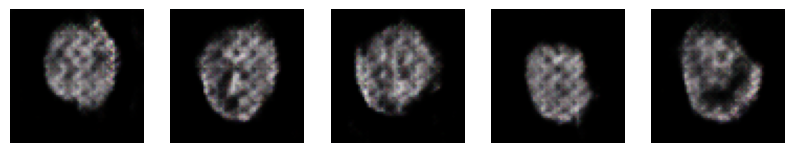

Epoch 39/100 completed


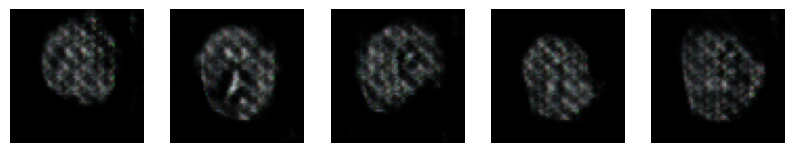

Epoch 40/100 completed


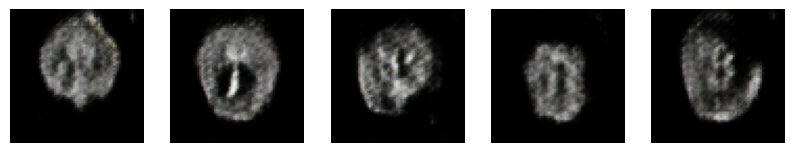

Epoch 41/100 completed


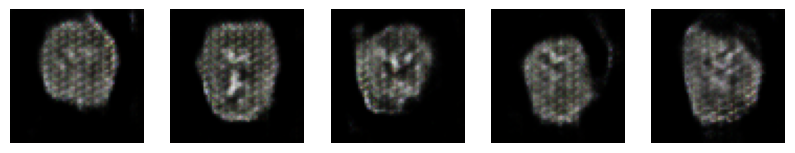

Epoch 42/100 completed


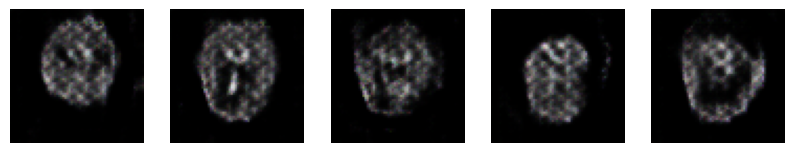

Epoch 43/100 completed


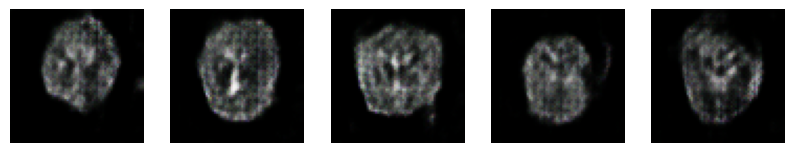

Epoch 44/100 completed


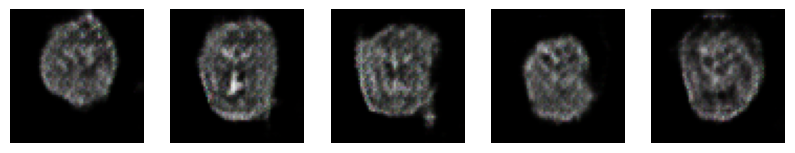

Epoch 45/100 completed


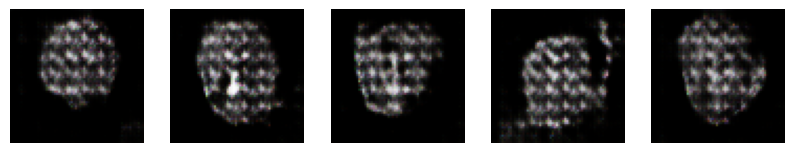

Epoch 46/100 completed


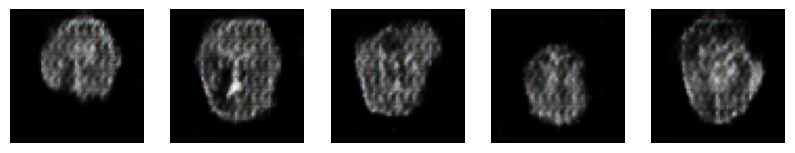

Epoch 47/100 completed


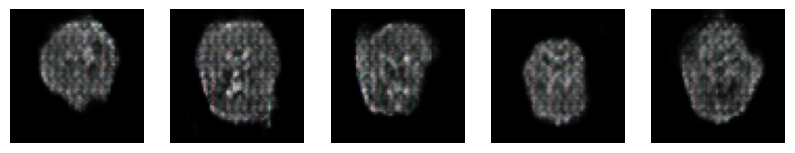

Epoch 48/100 completed


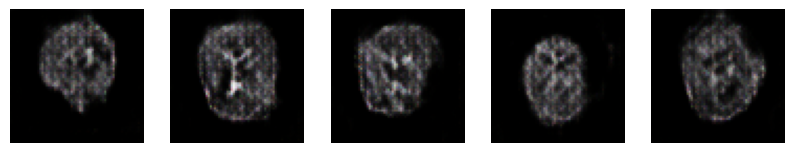

Epoch 49/100 completed


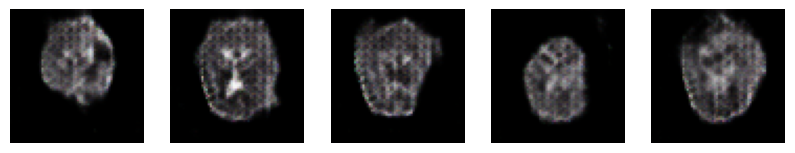

Epoch 50/100 completed


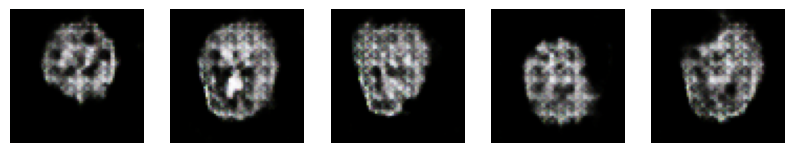

Epoch 51/100 completed


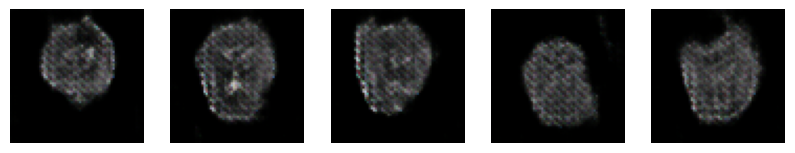

Epoch 52/100 completed


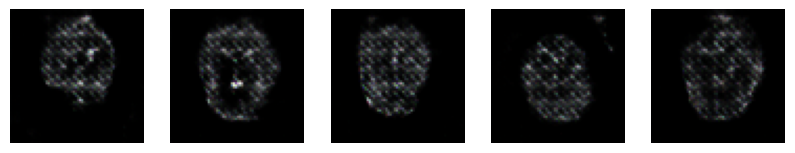

Epoch 53/100 completed


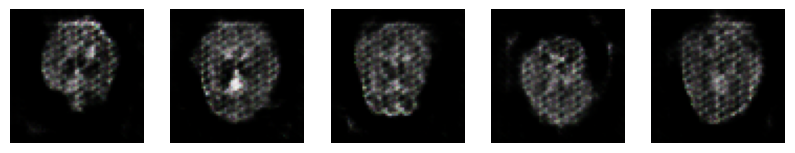

Epoch 54/100 completed


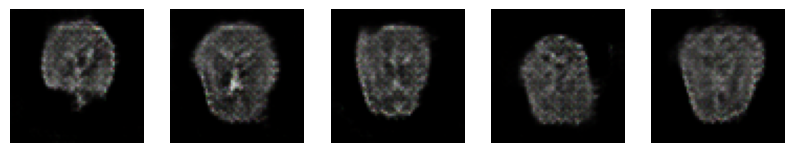

Epoch 55/100 completed


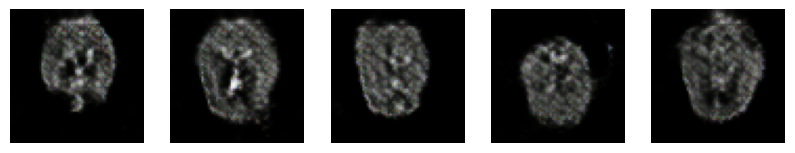

Epoch 56/100 completed


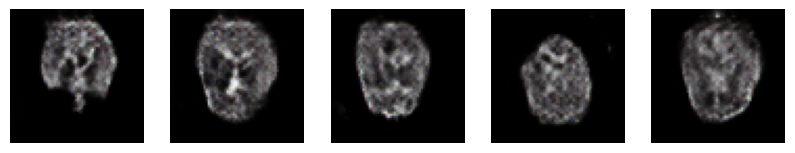

Epoch 57/100 completed


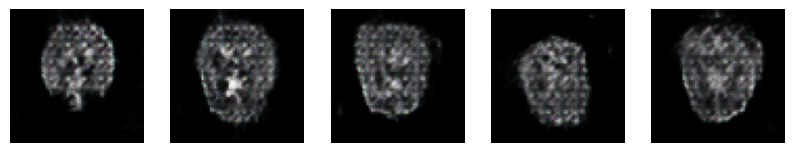

Epoch 58/100 completed


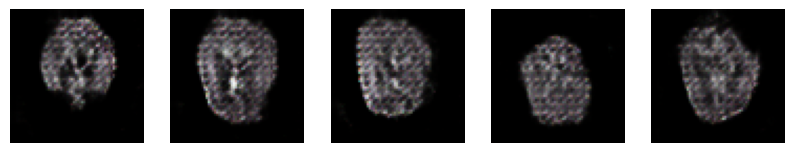

Epoch 59/100 completed


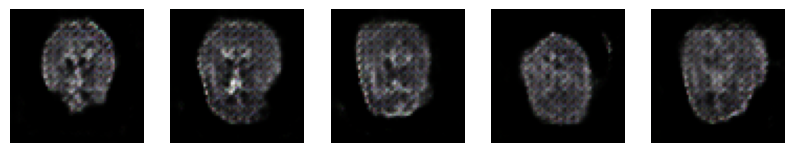

Epoch 60/100 completed


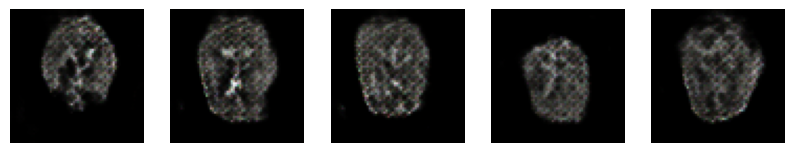

Epoch 61/100 completed


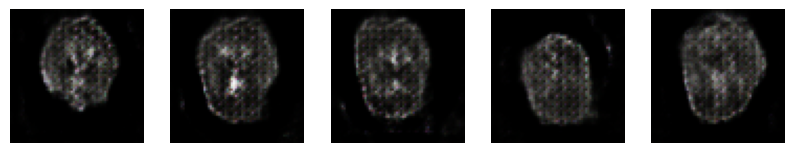

Epoch 62/100 completed


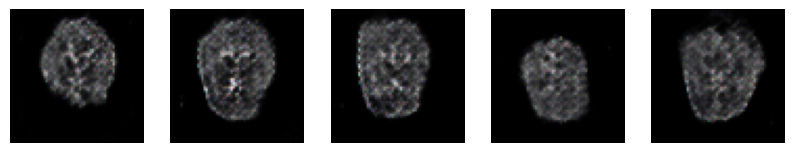

Epoch 63/100 completed


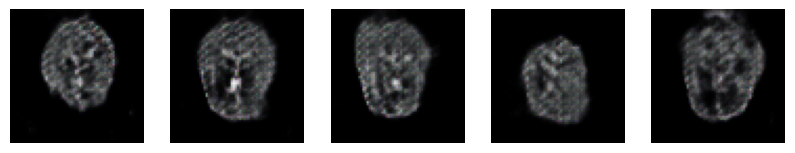

Epoch 64/100 completed


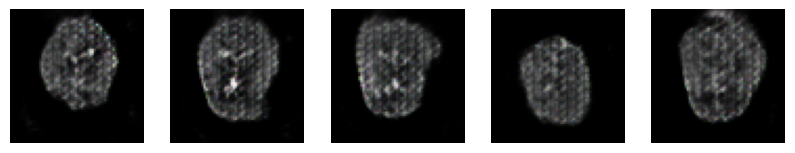

Epoch 65/100 completed


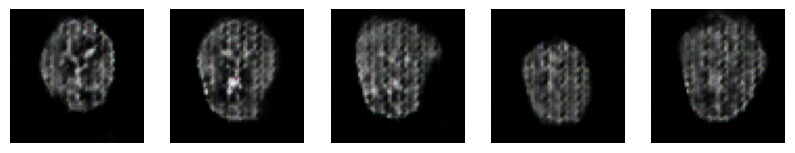

Epoch 66/100 completed


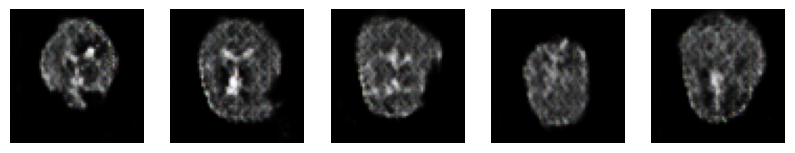

Epoch 67/100 completed


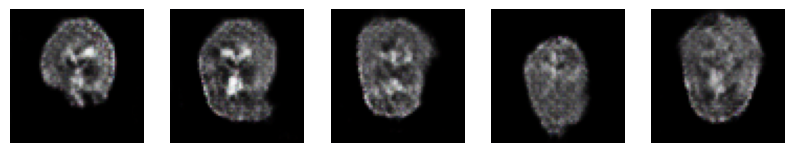

Epoch 68/100 completed


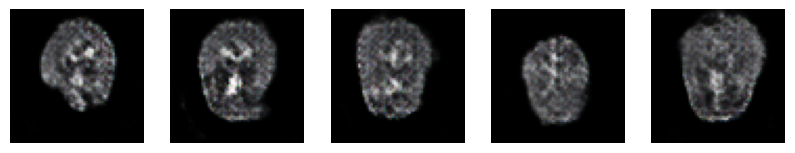

Epoch 69/100 completed


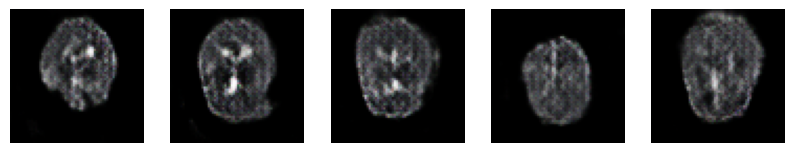

Epoch 70/100 completed


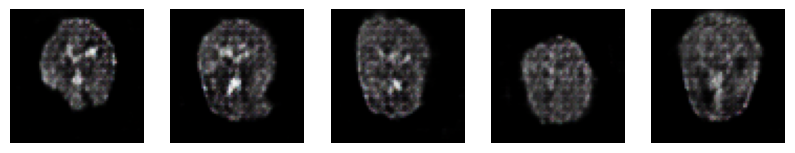

Epoch 71/100 completed


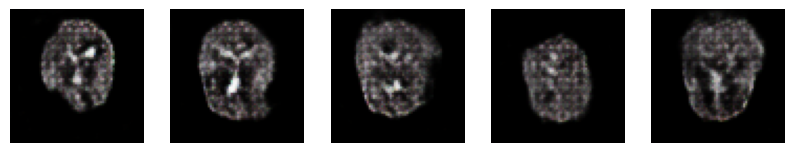

Epoch 72/100 completed


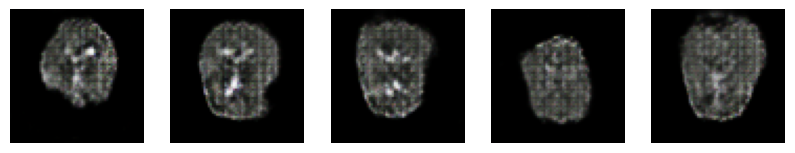

Epoch 73/100 completed


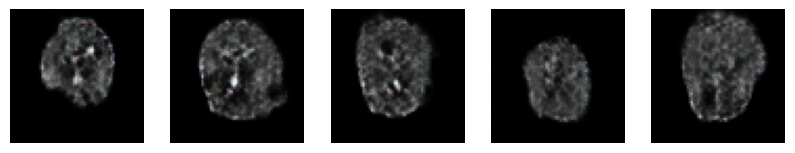

Epoch 74/100 completed


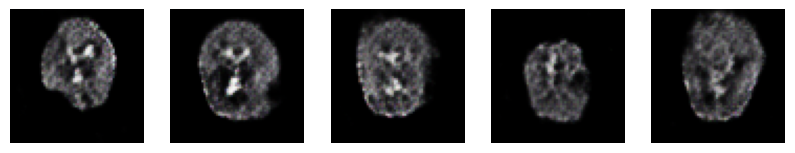

Epoch 75/100 completed


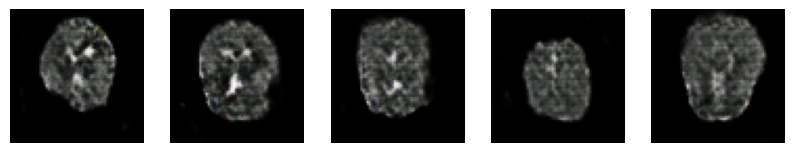

Epoch 76/100 completed


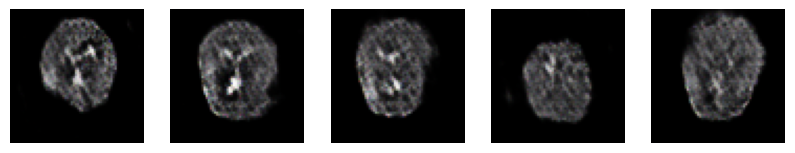

Epoch 77/100 completed


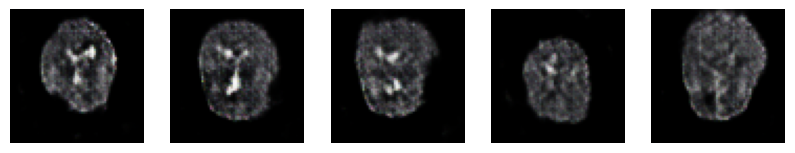

Epoch 78/100 completed


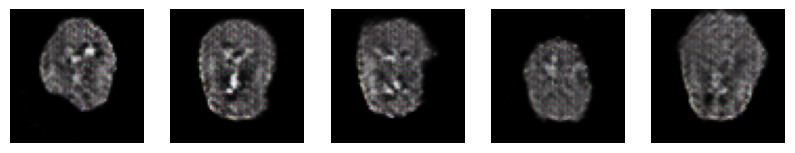

Epoch 79/100 completed


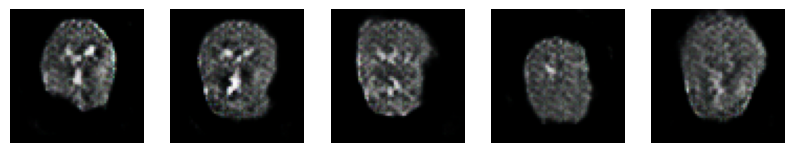

Epoch 80/100 completed


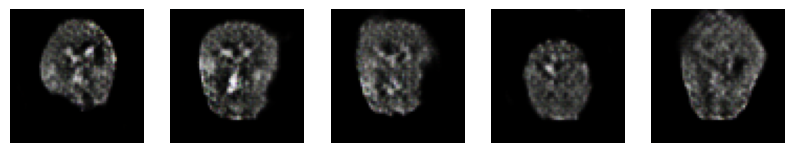

Epoch 81/100 completed


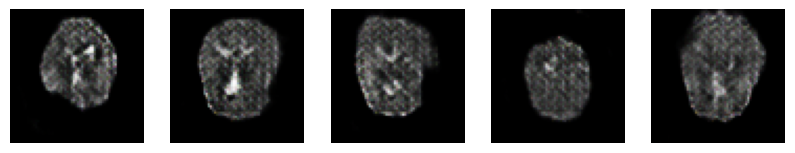

Epoch 82/100 completed


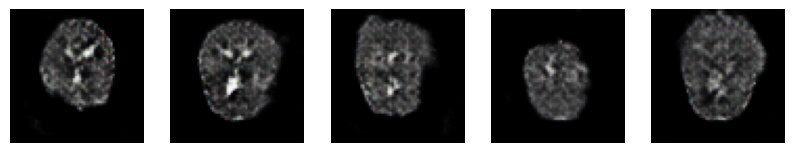

Epoch 83/100 completed


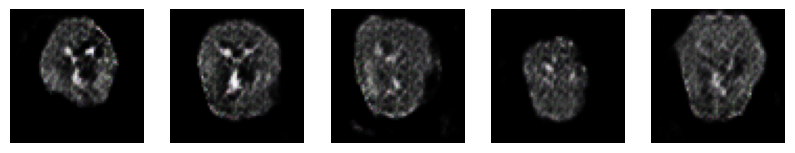

Epoch 84/100 completed


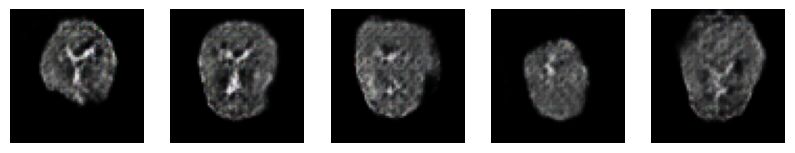

Epoch 85/100 completed


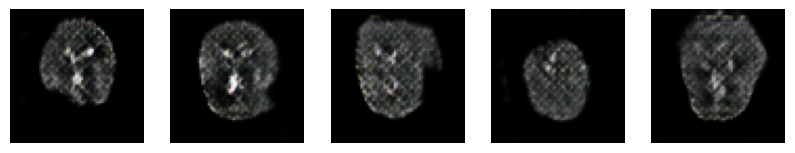

Epoch 86/100 completed


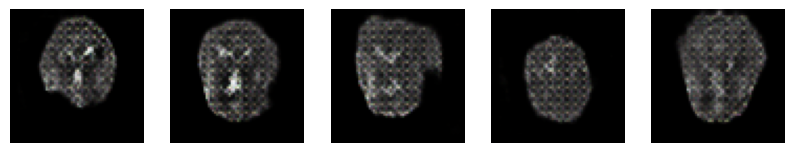

Epoch 87/100 completed


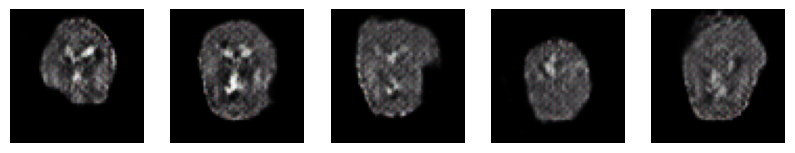

Epoch 88/100 completed


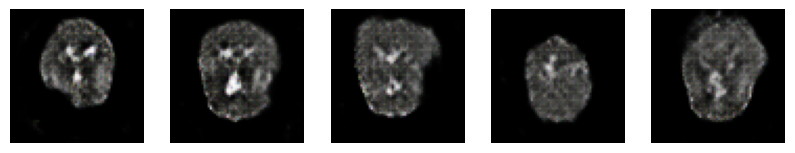

Epoch 89/100 completed


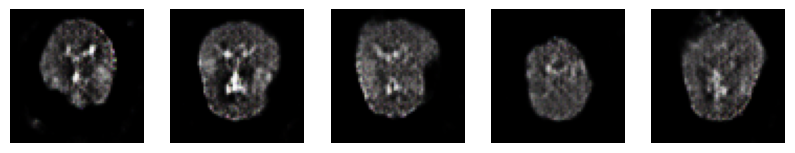

Epoch 90/100 completed


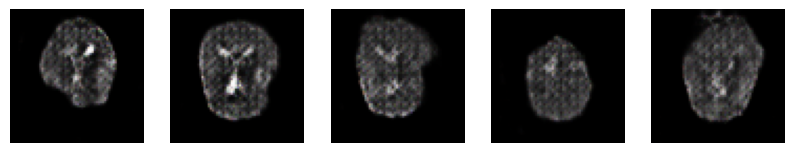

Epoch 91/100 completed


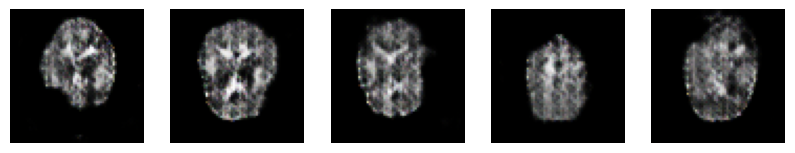

Epoch 92/100 completed


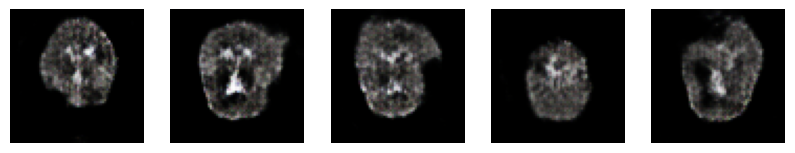

Epoch 93/100 completed


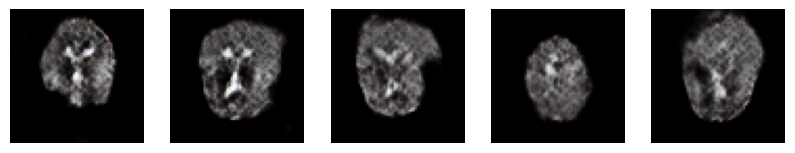

Epoch 94/100 completed


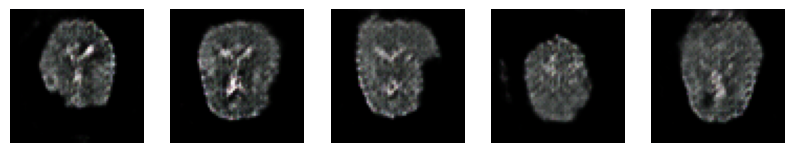

Epoch 95/100 completed


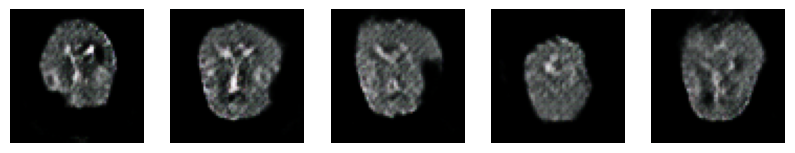

Epoch 96/100 completed


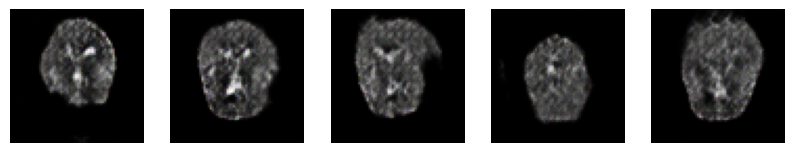

Epoch 97/100 completed


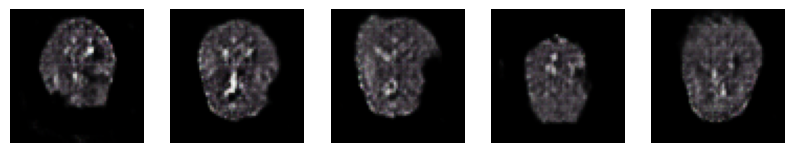

Epoch 98/100 completed


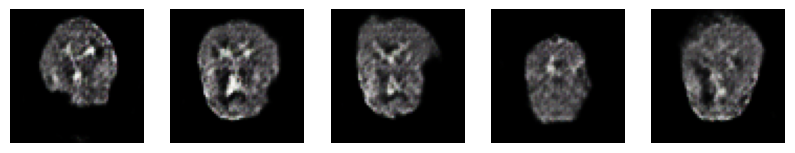

Epoch 99/100 completed


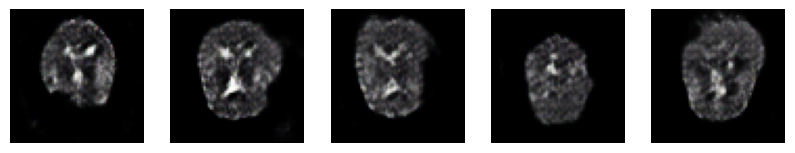

Epoch 100/100 completed


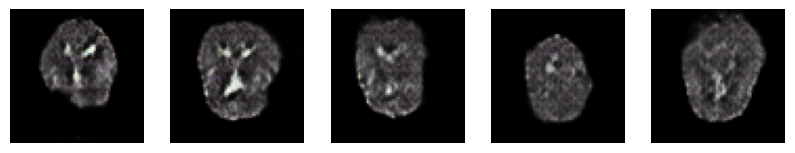

In [ ]:
# Entrenar el GAN con imágenes de Parkinson
gan_generated_pd_path = "/home/crakerool/Parkinson UCN/Parkinson/ganGenerated/PD"
print("Entrenando GAN con imágenes de Parkinson...")
train(dataset_pd, EPOCHS, gan_generated_pd_path)


Entrenando GAN con imágenes de Control...


2024-11-07 16:52:03.602927: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [6020,64,64,3]
	 [[{{node Placeholder/_0}}]]
2024-11-07 16:52:03.603135: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [6020,64,64,3]
	 [[{{node Placeholder/_0}}]]


Epoch 1/100 completed


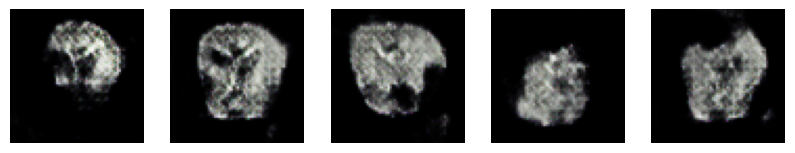

Epoch 2/100 completed


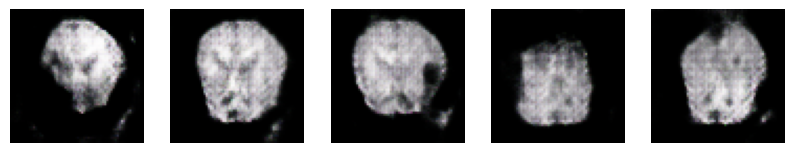

Epoch 3/100 completed


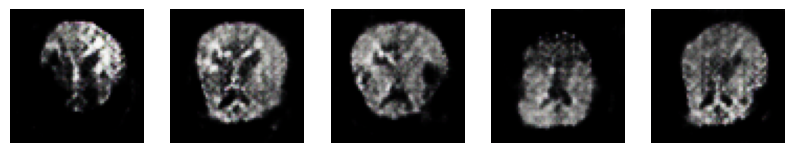

Epoch 4/100 completed


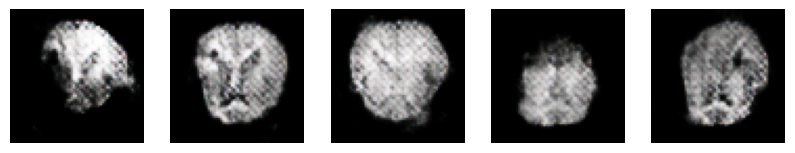

Epoch 5/100 completed


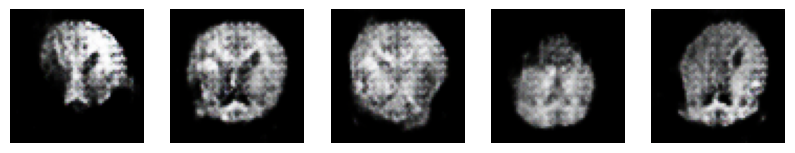

Epoch 6/100 completed


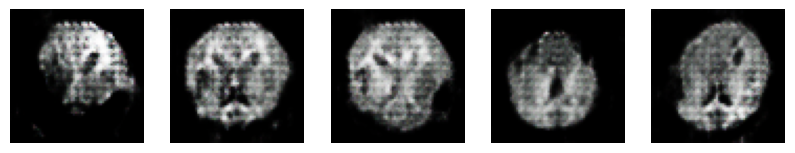

Epoch 7/100 completed


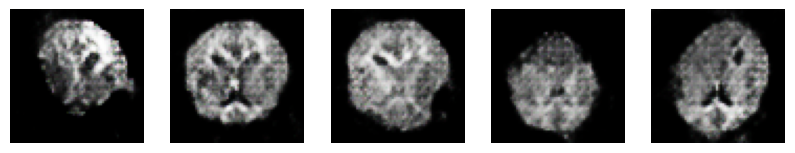

Epoch 8/100 completed


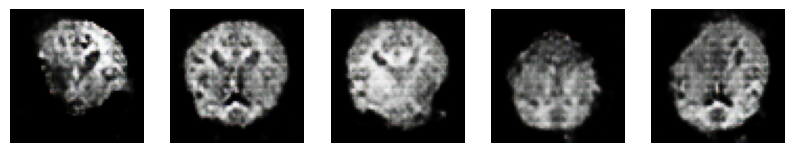

Epoch 9/100 completed


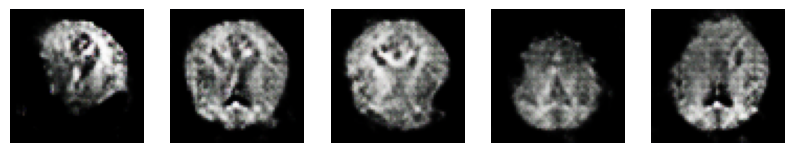

Epoch 10/100 completed


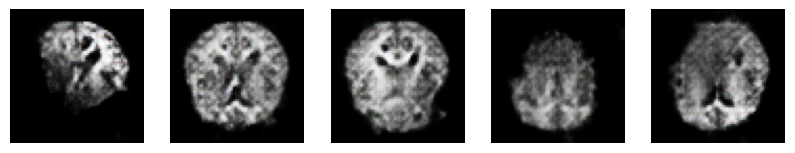

Epoch 11/100 completed


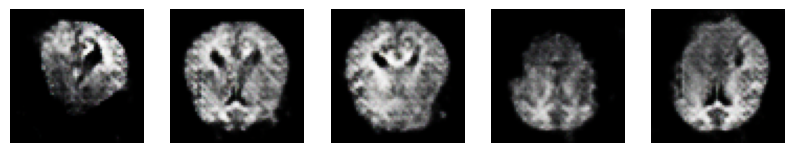

Epoch 12/100 completed


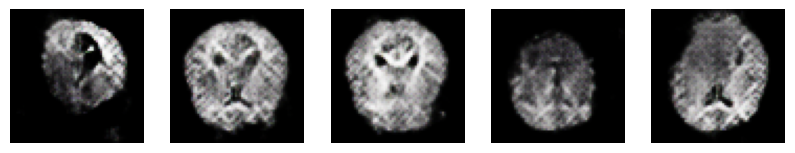

Epoch 13/100 completed


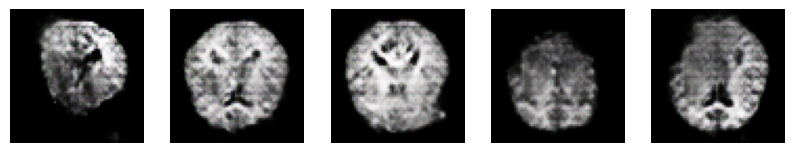

Epoch 14/100 completed


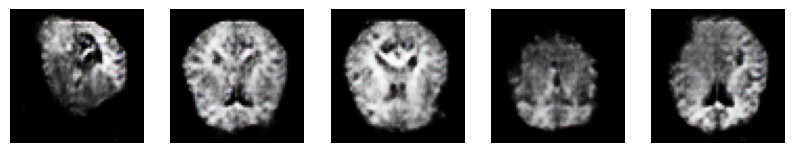

Epoch 15/100 completed


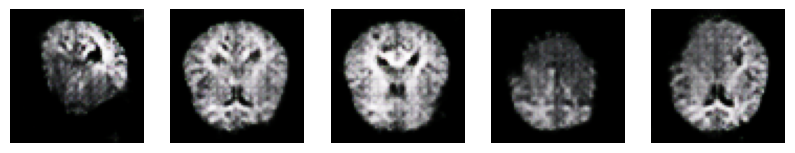

Epoch 16/100 completed


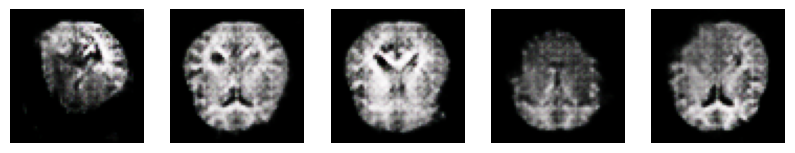

Epoch 17/100 completed


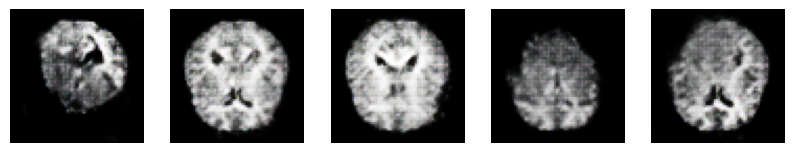

Epoch 18/100 completed


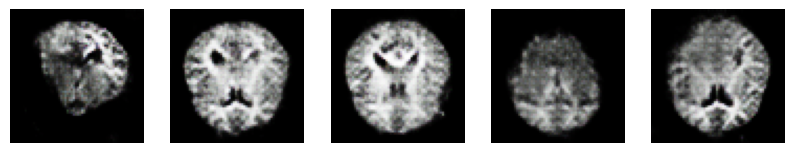

Epoch 19/100 completed


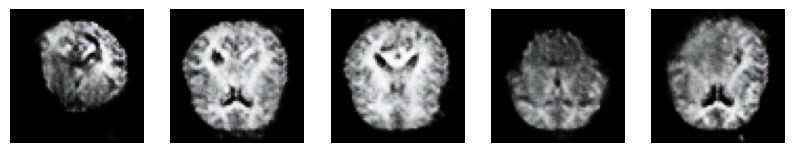

Epoch 20/100 completed


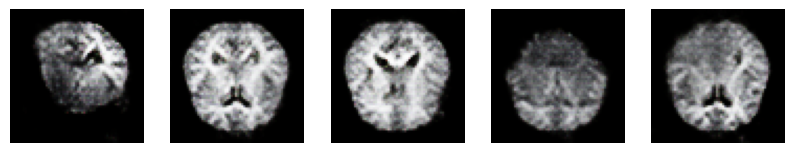

Epoch 21/100 completed


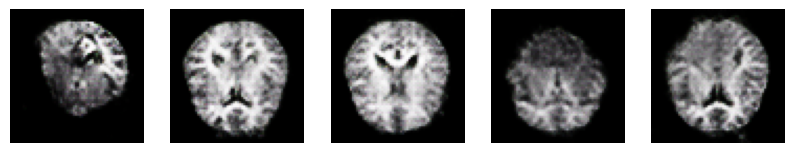

Epoch 22/100 completed


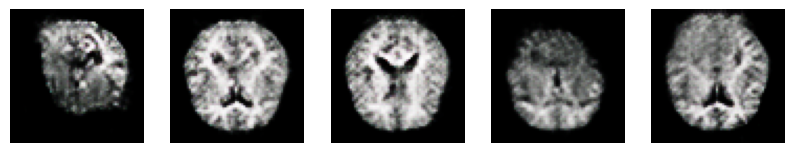

Epoch 23/100 completed


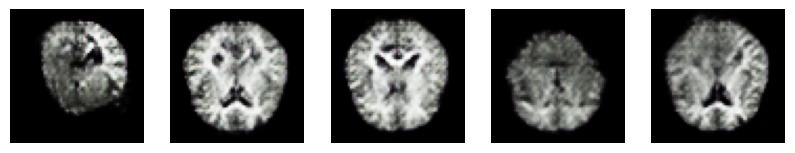

Epoch 24/100 completed


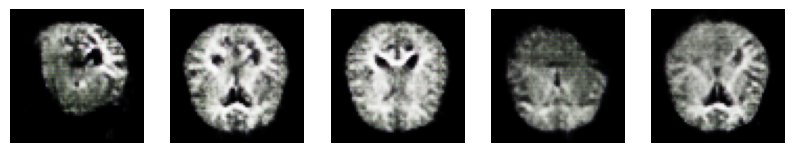

Epoch 25/100 completed


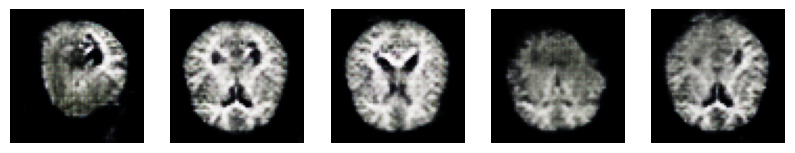

Epoch 26/100 completed


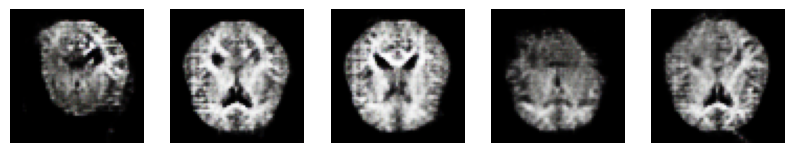

Epoch 27/100 completed


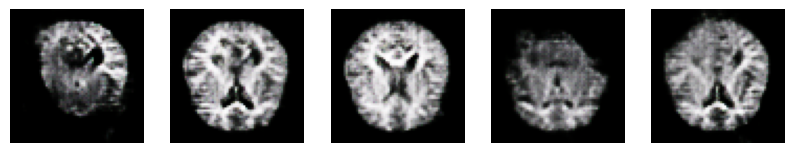

Epoch 28/100 completed


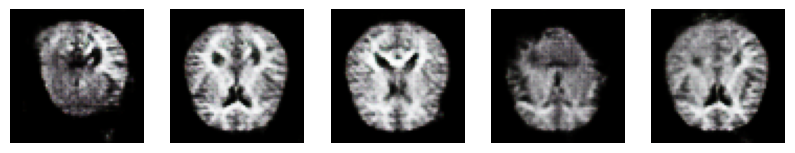

Epoch 29/100 completed


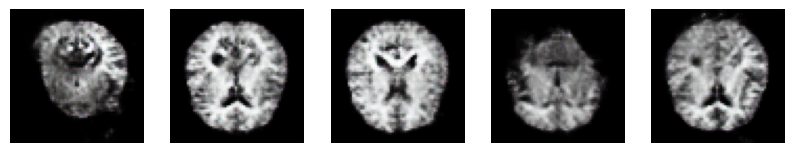

Epoch 30/100 completed


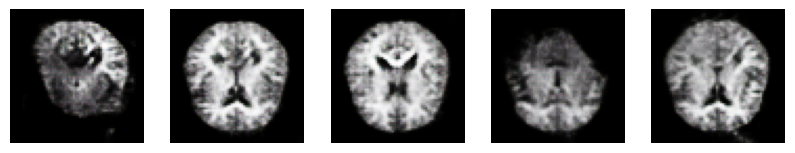

Epoch 31/100 completed


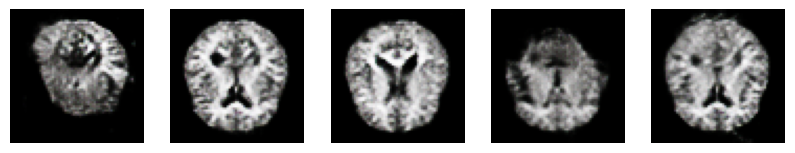

Epoch 32/100 completed


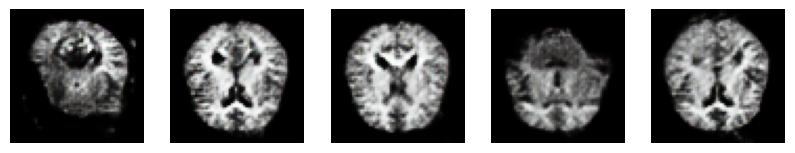

Epoch 33/100 completed


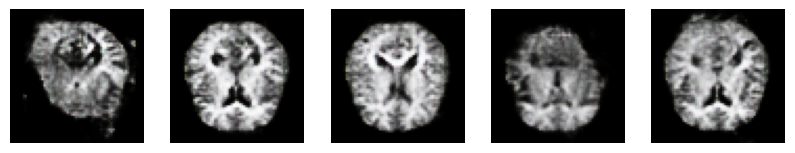

Epoch 34/100 completed


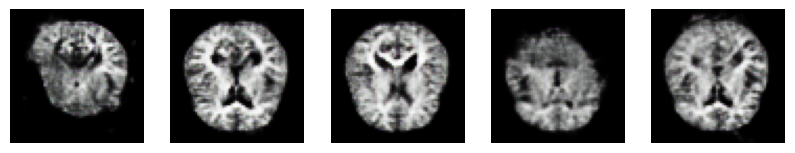

Epoch 35/100 completed


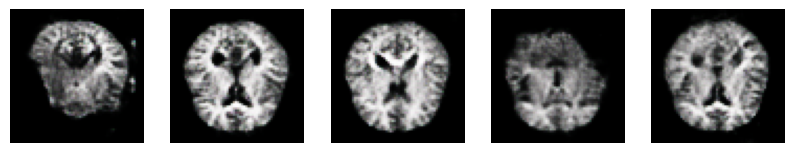

Epoch 36/100 completed


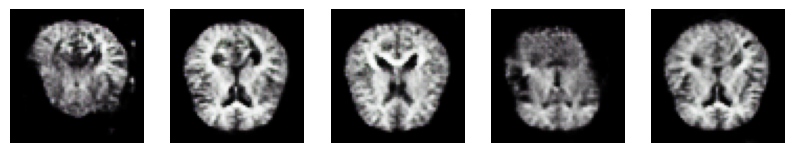

Epoch 37/100 completed


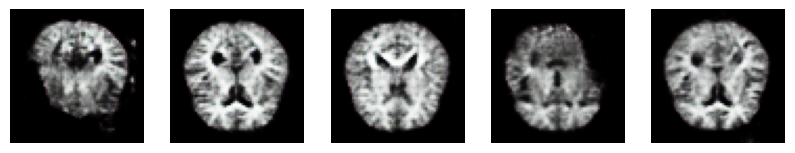

Epoch 38/100 completed


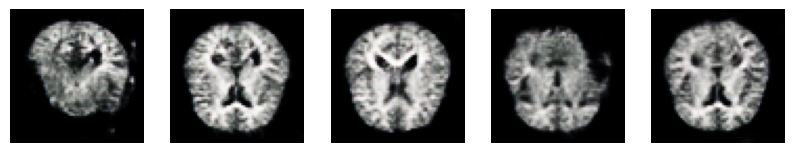

Epoch 39/100 completed


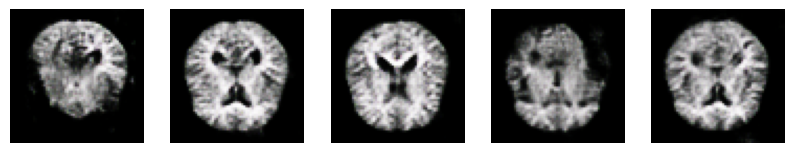

Epoch 40/100 completed


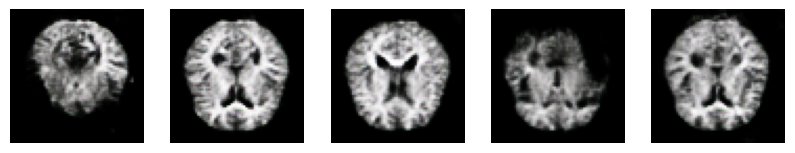

Epoch 41/100 completed


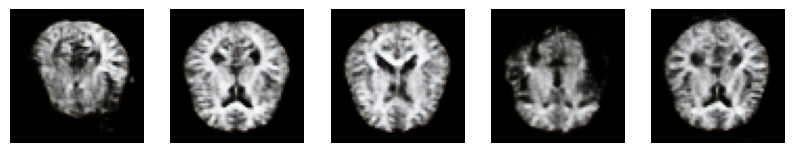

Epoch 42/100 completed


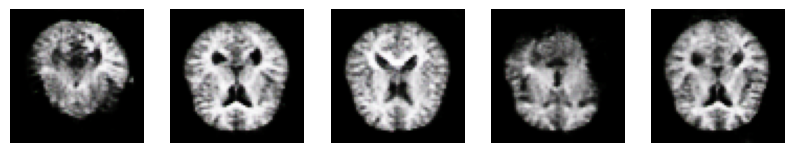

Epoch 43/100 completed


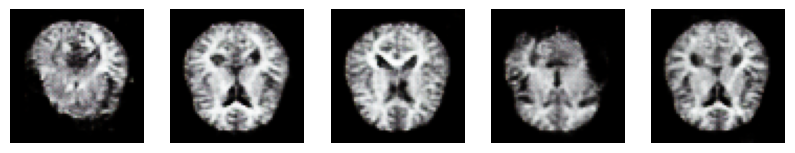

Epoch 44/100 completed


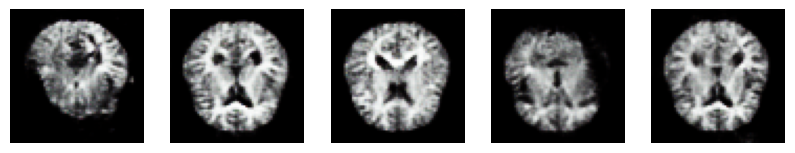

Epoch 45/100 completed


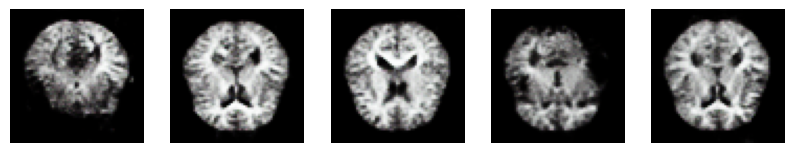

Epoch 46/100 completed


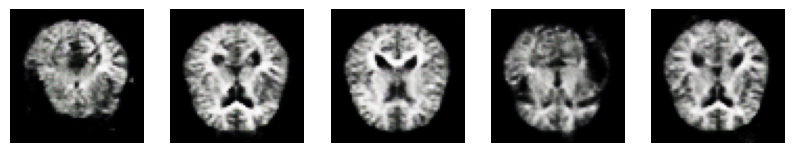

Epoch 47/100 completed


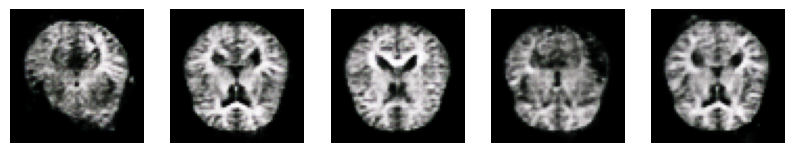

Epoch 48/100 completed


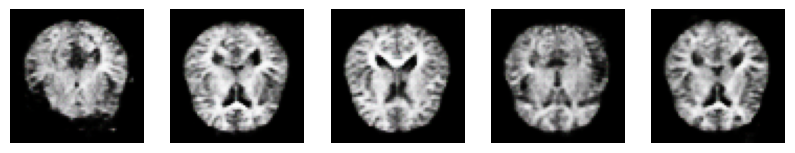

Epoch 49/100 completed


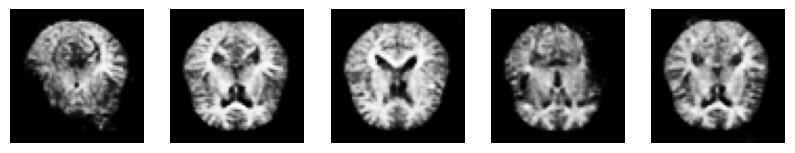

Epoch 50/100 completed


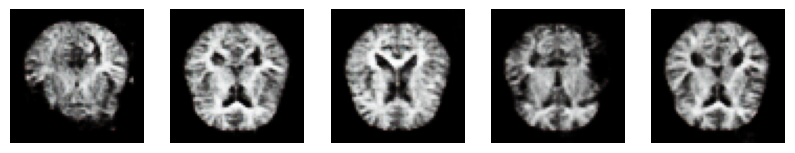

Epoch 51/100 completed


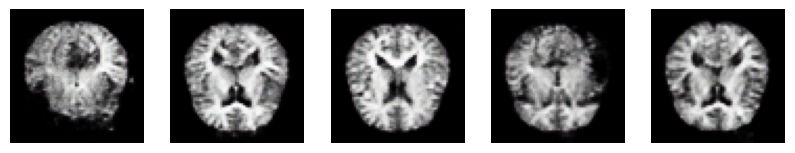

Epoch 52/100 completed


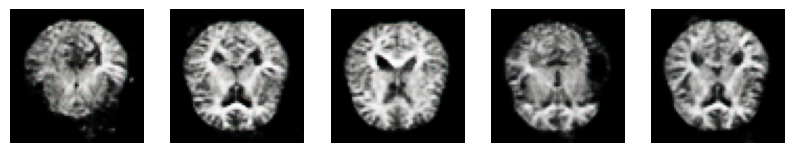

Epoch 53/100 completed


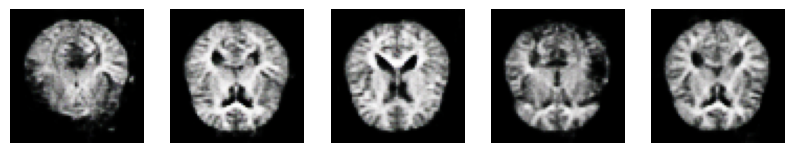

Epoch 54/100 completed


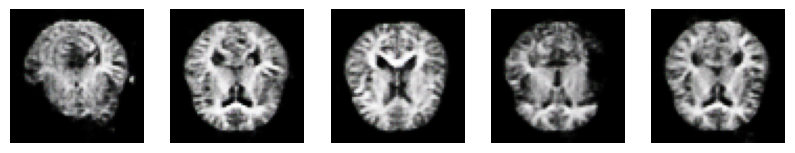

Epoch 55/100 completed


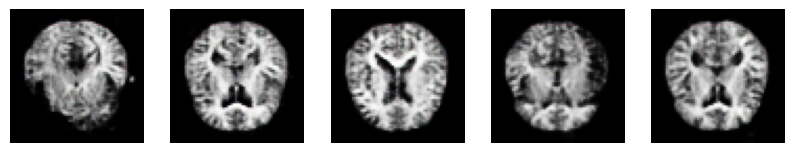

Epoch 56/100 completed


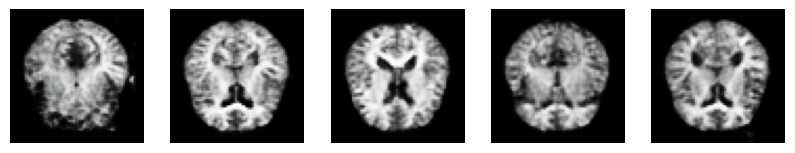

Epoch 57/100 completed


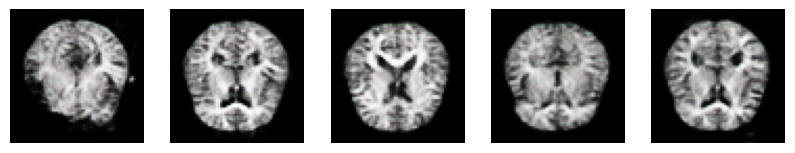

Epoch 58/100 completed


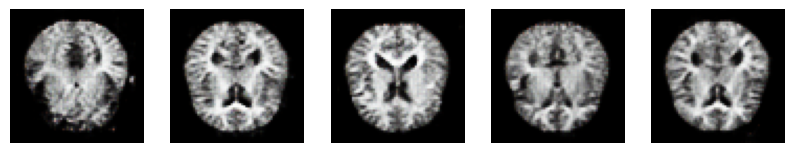

Epoch 59/100 completed


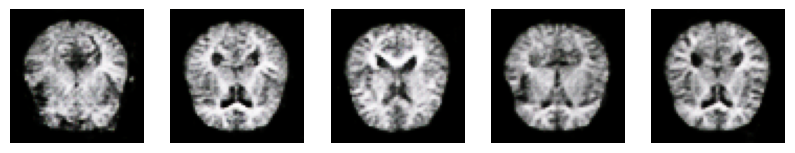

Epoch 60/100 completed


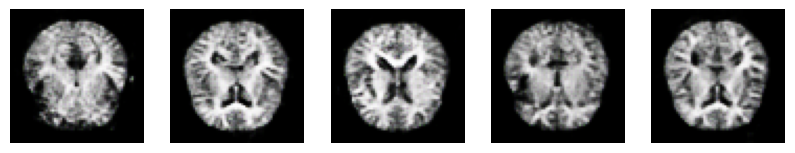

Epoch 61/100 completed


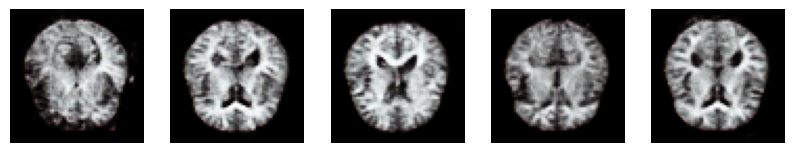

Epoch 62/100 completed


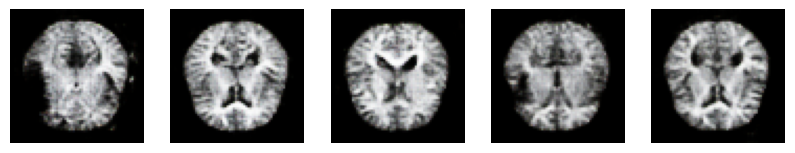

Epoch 63/100 completed


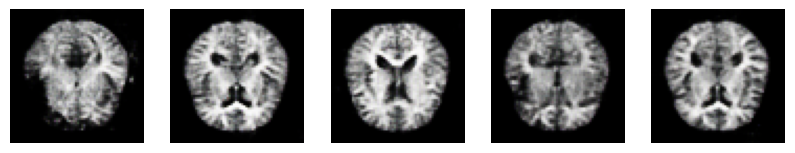

Epoch 64/100 completed


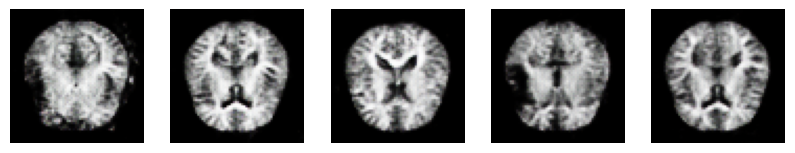

Epoch 65/100 completed


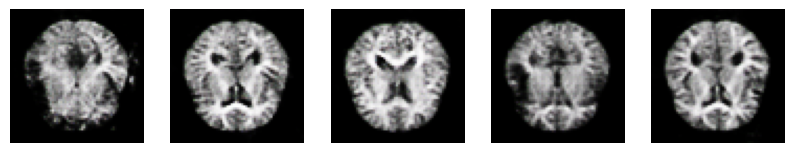

Epoch 66/100 completed


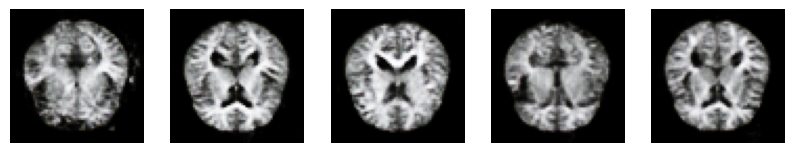

Epoch 67/100 completed


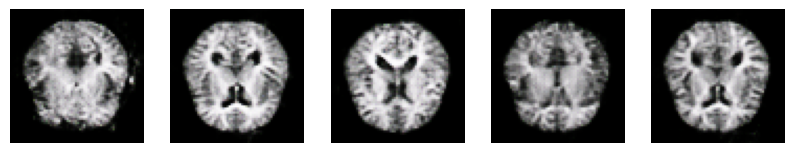

Epoch 68/100 completed


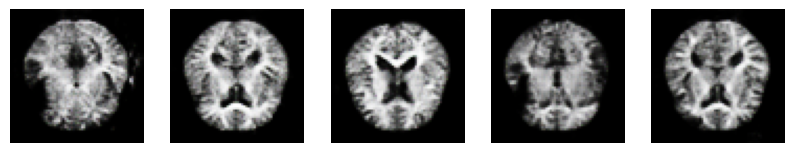

Epoch 69/100 completed


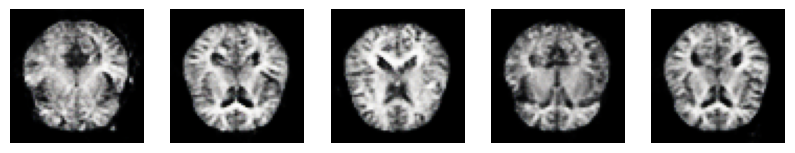

Epoch 70/100 completed


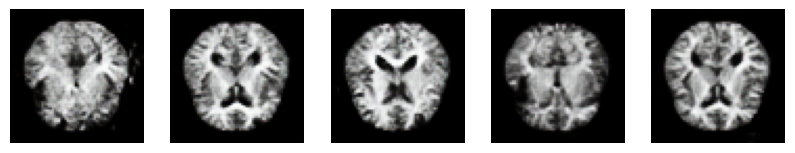

Epoch 71/100 completed


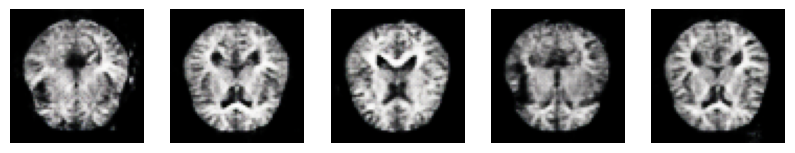

Epoch 72/100 completed


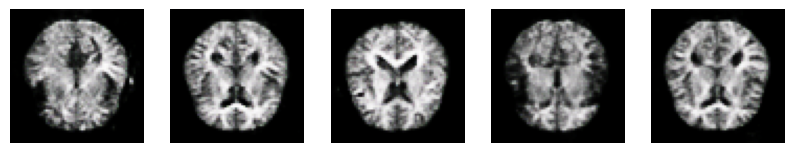

Epoch 73/100 completed


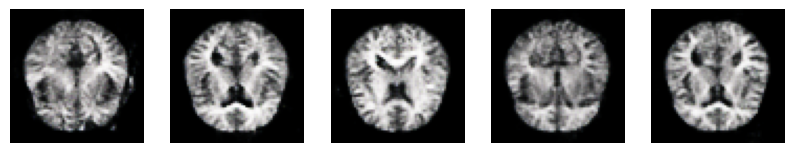

Epoch 74/100 completed


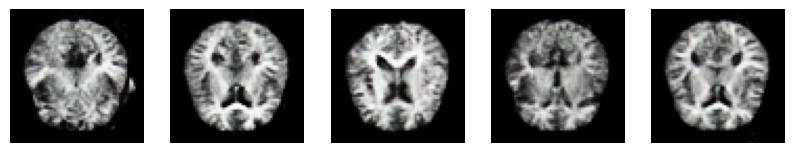

Epoch 75/100 completed


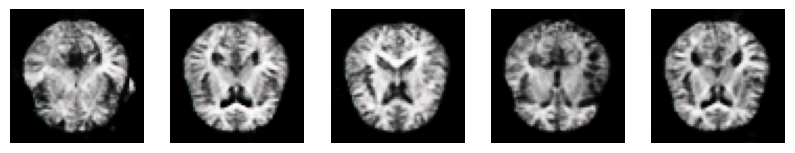

Epoch 76/100 completed


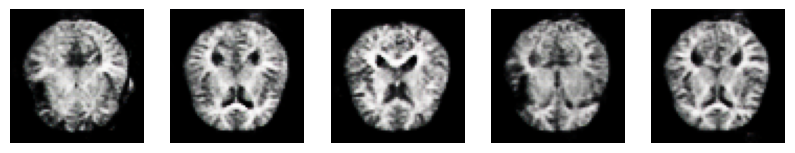

Epoch 77/100 completed


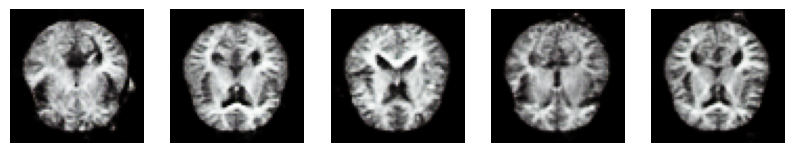

Epoch 78/100 completed


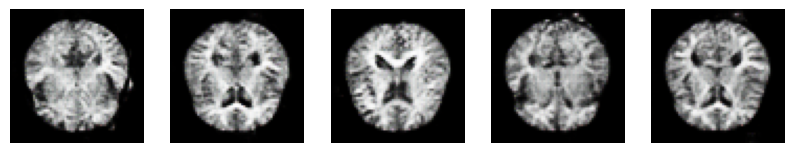

Epoch 79/100 completed


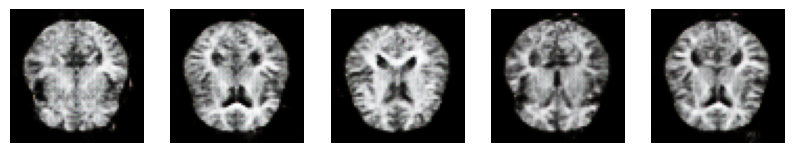

Epoch 80/100 completed


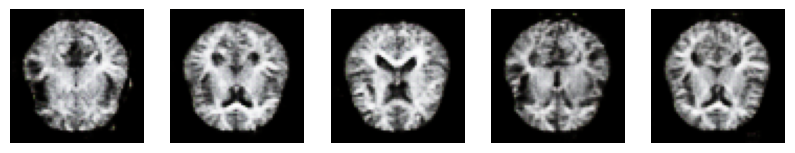

Epoch 81/100 completed


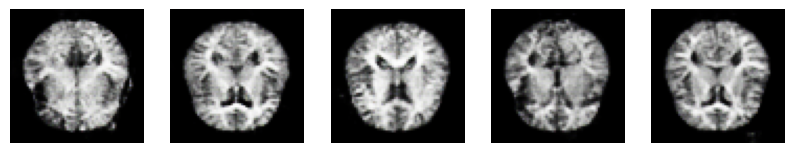

Epoch 82/100 completed


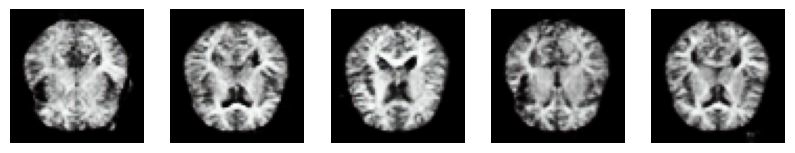

Epoch 83/100 completed


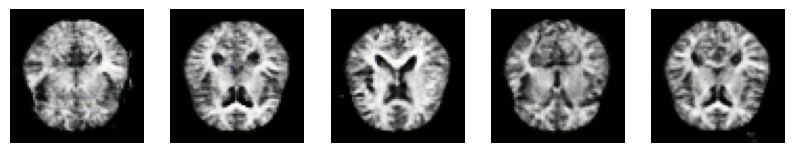

Epoch 84/100 completed


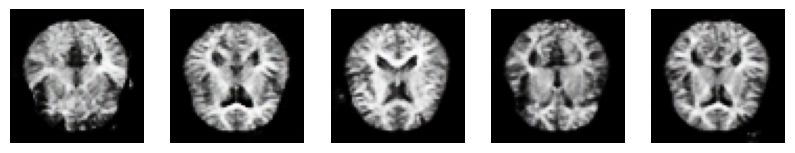

Epoch 85/100 completed


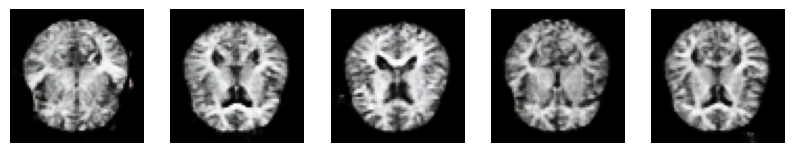

Epoch 86/100 completed


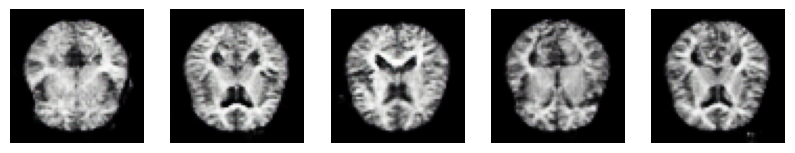

Epoch 87/100 completed


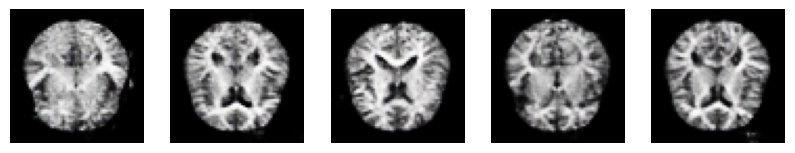

Epoch 88/100 completed


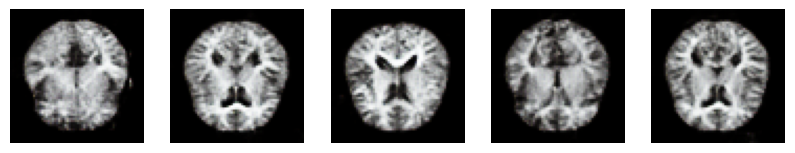

Epoch 89/100 completed


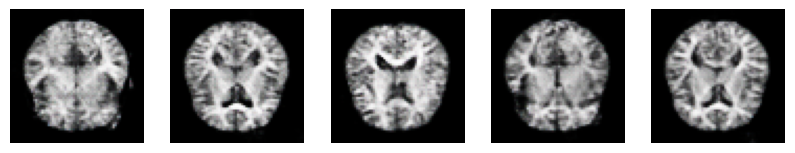

Epoch 90/100 completed


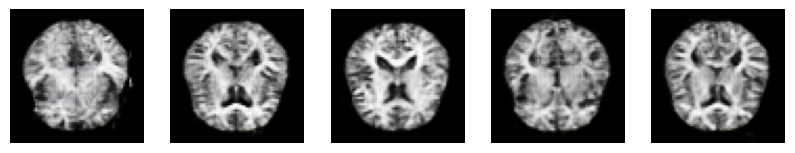

Epoch 91/100 completed


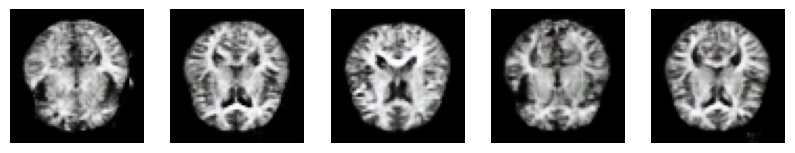

Epoch 92/100 completed


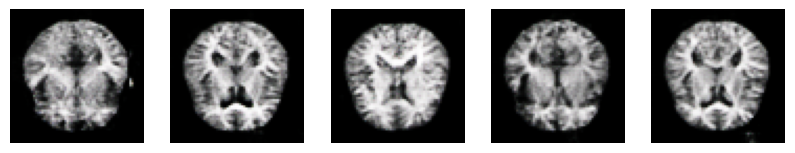

Epoch 93/100 completed


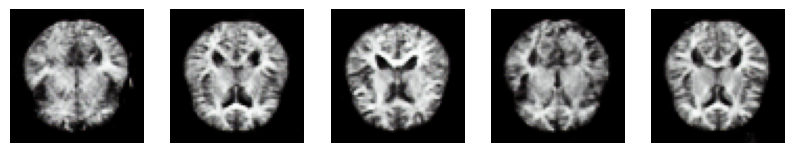

Epoch 94/100 completed


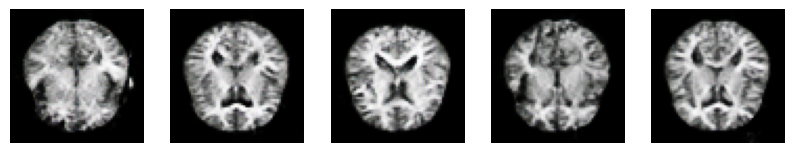

Epoch 95/100 completed


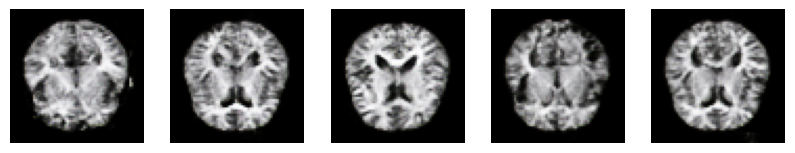

Epoch 96/100 completed


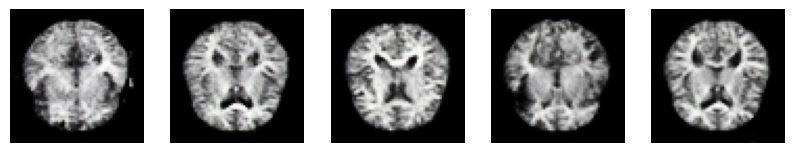

Epoch 97/100 completed


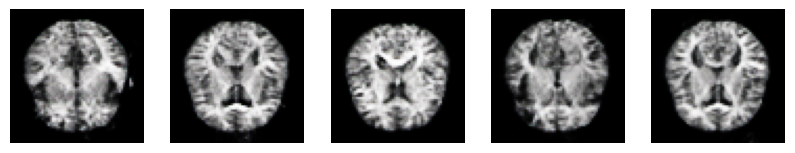

Epoch 98/100 completed


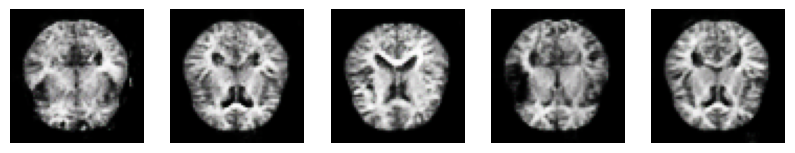

Epoch 99/100 completed


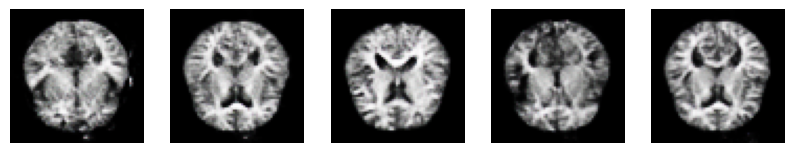

Epoch 100/100 completed


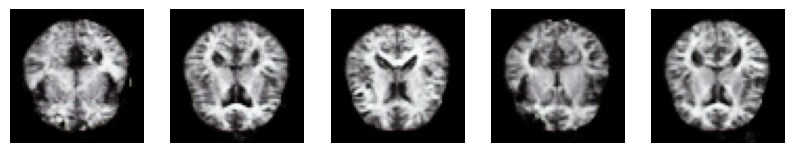

In [ ]:
# Entrenar el GAN con imágenes de Control
gan_generated_control_path = "/home/crakerool/Parkinson UCN/Parkinson/ganGenerated/CONTROL"
print("Entrenando GAN con imágenes de Control...")
train(dataset_control, EPOCHS, gan_generated_control_path)


In [ ]:
# Definición del modelo CNN
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),

    Conv2D(64, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),

    Conv2D(128, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),

    Flatten(),
    Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    Dense(1, activation='sigmoid')
])

# Compilación del modelo
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

In [ ]:
# Cargar y preparar las imágenes para el entrenamiento y validación de la CNN
train_datagen = ImageDataGenerator(rescale=1.0/255, validation_split=0.01)

train_generator = train_datagen.flow_from_directory(
    '/home/crakerool/Parkinson UCN/Parkinson/trainDatasets',
    classes=['PD', 'CONTROL'],
    target_size=(128, 128),
    batch_size=16,
    class_mode='binary',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    '/home/crakerool/Parkinson UCN/Parkinson/trainDatasets',
    classes=['PD', 'CONTROL'],
    target_size=(128, 128),
    batch_size=32,
    class_mode='binary',
    subset='validation'
)

Found 10445 images belonging to 2 classes.


Found 105 images belonging to 2 classes.


In [ ]:
# Entrenamiento del modelo
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=15,
    validation_data=validation_generator,
    validation_steps=len(validation_generator)
)


Epoch 1/15


2024-11-07 18:07:21.812503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


653/653 [==============================] - ETA: 0s - loss: 0.2308 - accuracy: 0.9108

2024-11-07 18:09:19.658992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


653/653 [==============================] - 118s 180ms/step - loss: 0.2308 - accuracy: 0.9108 - val_loss: 0.2150 - val_accuracy: 0.9143
Epoch 2/15
653/653 [==============================] - 107s 164ms/step - loss: 0.1905 - accuracy: 0.9198 - val_loss: 0.2221 - val_accuracy: 0.9143
Epoch 3/15
653/653 [==============================] - 112s 171ms/step - loss: 0.1498 - accuracy: 0.9331 - val_loss: 0.1511 - val_accuracy: 0.9429
Epoch 4/15
653/653 [==============================] - 120s 183ms/step - loss: 0.0884 - accuracy: 0.9639 - val_loss: 0.2296 - val_accuracy: 0.8952
Epoch 5/15
653/653 [==============================] - 104s 159ms/step - loss: 0.0420 - accuracy: 0.9832 - val_loss: 0.2959 - val_accuracy: 0.8857
Epoch 6/15
653/653 [==============================] - 123s 188ms/step - loss: 0.0213 - accuracy: 0.9927 - val_loss: 0.1312 - val_accuracy: 0.9333
Epoch 7/15
653/653 [==============================] - 103s 158ms/step - loss: 0.0156 - accuracy: 0.9944 - val_loss: 0.2889 - val_accura

In [ ]:
# Guardar los modelos generados (GAN y CNN)
generator.save('/home/crakerool/Parkinson UCN/Parkinson/models/generator_model.h5')
discriminator.save('/home/crakerool/Parkinson UCN/Parkinson/models/discriminator_model.h5')
model.save('/home/crakerool/Parkinson UCN/Parkinson/models/cnn_model.h5')


In [ ]:
# Gráficas de precisión del modelo CNN
plt.figure(figsize=(12, 4))


<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

In [ ]:
%pip install tensorflow-addons


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 4.8 MB/s eta 0:00:00-:--:--
Note: you may need to restart the kernel to use updated packages.


In [ ]:
import fid_score
import math
from sklearn.metrics import confusion_matrix, roc_curve, auc, precision_recall_curve
import seaborn as sns
import tensorflow_addons as tfa

/home/crakerool/miniconda3/envs/clean/lib/python3.11/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/home/crakerool/miniconda3/envs/clean/lib/python3.11/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.13.0 and strictly below 2.16.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.12.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, d

In [ ]:
# 1. Curva de Pérdida y Precisión para la CNN
def plot_loss_accuracy(history):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # Curva de pérdida
    ax1.plot(history.history['loss'], label='Train Loss')
    ax1.plot(history.history['val_loss'], label='Validation Loss')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss')
    ax1.set_title('Loss Curve')
    ax1.legend()

    # Curva de precisión
    ax2.plot(history.history['accuracy'], label='Train Accuracy')
    ax2.plot(history.history['val_accuracy'], label='Validation Accuracy')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Accuracy')
    ax2.set_title('Accuracy Curve')
    ax2.legend()

    plt.show()


In [ ]:
# 2. Matriz de Confusión
def plot_confusion_matrix(model, validation_generator):
    validation_generator.reset()
    Y_pred = model.predict(validation_generator, steps=len(validation_generator))
    y_pred = np.round(Y_pred).astype(int)
    cm = confusion_matrix(validation_generator.classes, y_pred)

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['CONTROL', 'PD'], yticklabels=['CONTROL', 'PD'])
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()


In [ ]:
# 3. Curva ROC y AUC
def plot_roc_curve(model, validation_generator):
    validation_generator.reset()
    Y_pred = model.predict(validation_generator, steps=len(validation_generator))
    fpr, tpr, _ = roc_curve(validation_generator.classes, Y_pred)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc='lower right')
    plt.show()

In [ ]:
# 4. Curva de Precisión-Recall
def plot_precision_recall_curve(model, validation_generator):
    validation_generator.reset()
    Y_pred = model.predict(validation_generator, steps=len(validation_generator))
    precision, recall, _ = precision_recall_curve(validation_generator.classes, Y_pred)

    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()


In [ ]:
# 5. Visualización de Filtros y Mapas de Características (CNN)
def visualize_feature_maps(model, input_image):
    layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]
    feature_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)
    feature_maps = feature_model.predict(input_image)

    for i, feature_map in enumerate(feature_maps):
        plt.figure(figsize=(15, 15))
        num_filters = feature_map.shape[-1]
        for j in range(num_filters):
            plt.subplot(8, 8, j+1)
            plt.imshow(feature_map[0, :, :, j], cmap='viridis')
            plt.axis('off')
        plt.suptitle(f'Feature Maps of Layer {i+1}')
        plt.show()

In [ ]:
# 6. Gráficas para el GAN: Pérdida del Generador y Discriminador
def plot_gan_losses(generator_losses, discriminator_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(generator_losses, label='Generator Loss')
    plt.plot(discriminator_losses, label='Discriminator Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('GAN Losses')
    plt.legend()
    plt.show()

In [ ]:
# 7. Visualización de Imágenes Generadas por GAN
def plot_generated_images(generator, epoch, num_examples=5):
    noise = tf.random.normal([num_examples, NOISE_DIM])
    generated_images = generator(noise, training=False)

    fig = plt.figure(figsize=(10, 10))
    for i in range(num_examples):
        plt.subplot(1, num_examples, i+1)
        plt.imshow((generated_images[i] + 1) / 2)
        plt.axis('off')
    plt.suptitle(f'Generated Images at Epoch {epoch}')
    plt.show()

In [ ]:
def calculate_fid(real_images, generated_images):
    fid = fid_score.calculate_frechet_inception_distance(real_images, generated_images)
    print(f'Frechet Inception Distance (FID): {fid:.2f}')

In [ ]:
# 9. Inception Score (IS)
def calculate_inception_score(generator, num_samples=5000, batch_size=50):
    noise = tf.random.normal([num_samples, NOISE_DIM])
    generated_images = generator(noise, training=False)
    # Inception score calculation logic here (placeholder as IS implementation is complex)
    inception_score = 0  # Replace with actual calculation
    print(f'Inception Score (IS): {inception_score:.2f}')

In [ ]:
# 10. Interpolación Latente
def plot_latent_interpolation(generator, num_interpolations=10):
    noise_1 = tf.random.normal([1, NOISE_DIM])
    noise_2 = tf.random.normal([1, NOISE_DIM])
    alpha_values = np.linspace(0, 1, num_interpolations)

    fig, axes = plt.subplots(1, num_interpolations, figsize=(20, 5))
    for i, alpha in enumerate(alpha_values):
        interpolated_noise = (1 - alpha) * noise_1 + alpha * noise_2
        generated_image = generator(interpolated_noise, training=False)
        axes[i].imshow((generated_image[0] + 1) / 2)
        axes[i].axis('off')
    plt.suptitle('Latent Space Interpolation')
    plt.show()


In [ ]:
# 11. Distribución del Espacio Latente
def plot_latent_space_distribution(generator, num_samples=1000):
    noise = tf.random.normal([num_samples, NOISE_DIM])
    generated_images = generator(noise, training=False)
    mean_images = np.mean(generated_images, axis=(1, 2, 3))

    plt.figure(figsize=(8, 6))
    plt.hist(mean_images, bins=50, color='skyblue', edgecolor='black')
    plt.xlabel('Mean Pixel Value')
    plt.ylabel('Frequency')
    plt.title('Latent Space Distribution')
    plt.show()


In [ ]:
# 12. Grad-CAM (Gradient-weighted Class Activation Mapping)
def plot_grad_cam(model, img_array, layer_name='conv2d_3'):
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, 0]
    grads = tape.gradient(loss, conv_outputs)
    guided_grads = tf.cast(conv_outputs > 0, "float32") * tf.cast(grads > 0, "float32") * grads
    weights = tf.reduce_mean(guided_grads, axis=(0, 1, 2))
    cam = tf.reduce_sum(tf.multiply(weights, conv_outputs), axis=-1)
    heatmap = np.maximum(cam[0], 0) / np.max(cam[0])
    plt.matshow(heatmap)
    plt.title('Grad-CAM')
    plt.show()


In [ ]:

# 13. Mapa de Calor de Activaciones
def plot_activation_heatmaps(model, input_image):
    layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]
    feature_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)
    feature_maps = feature_model.predict(input_image)
    for i, feature_map in enumerate(feature_maps):
        plt.figure(figsize=(15, 15))
        num_filters = feature_map.shape[-1]
        for j in range(num_filters):
            plt.subplot(8, 8, j+1)
            plt.imshow(feature_map[0, :, :, j], cmap='hot')
            plt.axis('off')
        plt.suptitle(f'Activation Heatmaps of Layer {i+1}')
        plt.show()

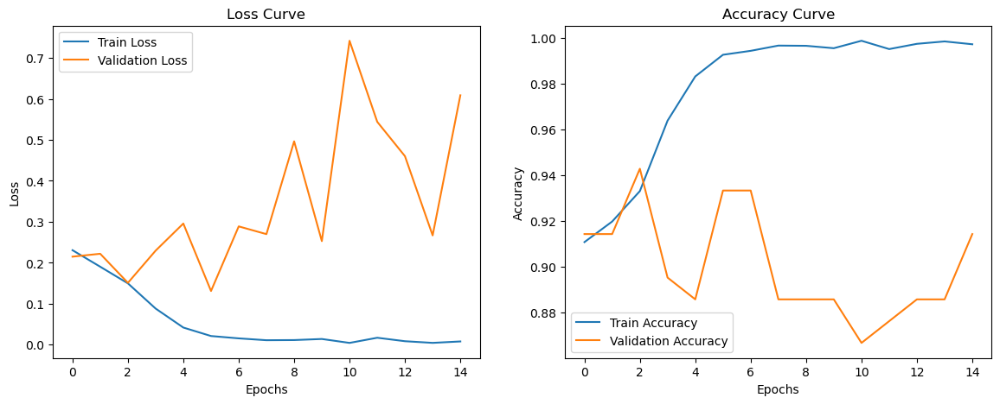

1/4 [======>.......................] - ETA: 0s

2024-11-07 19:09:06.040338: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


4/4 [==============================] - 0s 83ms/step


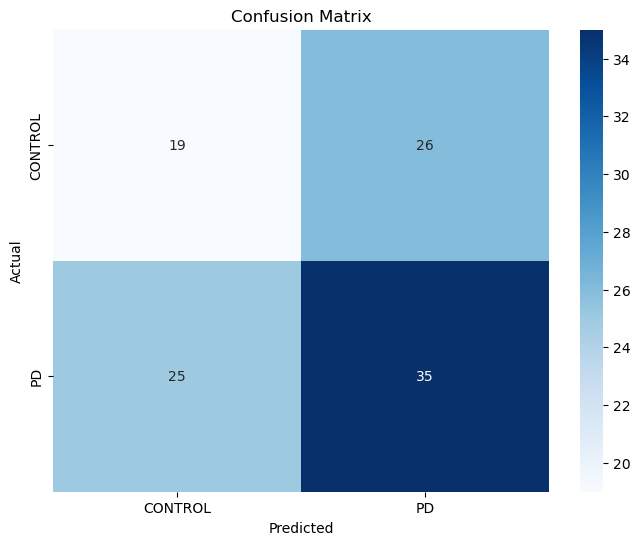

2/4 [==============>...............] - ETA: 0s

2024-11-07 19:09:06.657946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


4/4 [==============================] - 0s 91ms/step


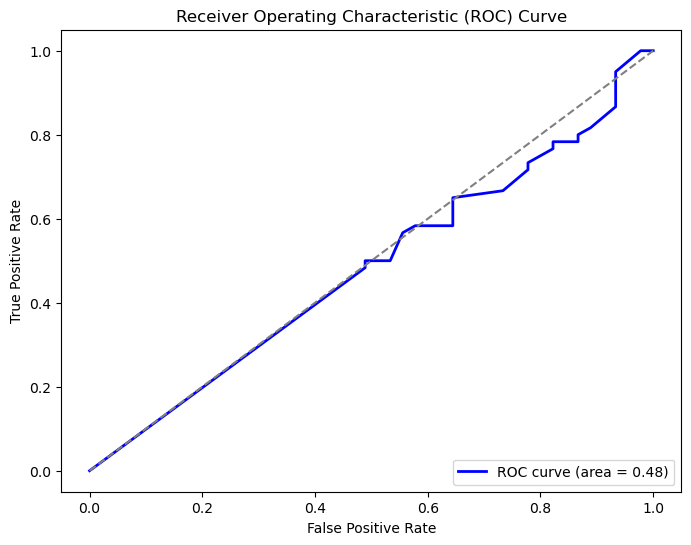

1/4 [======>.......................] - ETA: 0s

2024-11-07 19:09:07.256157: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


4/4 [==============================] - 0s 87ms/step


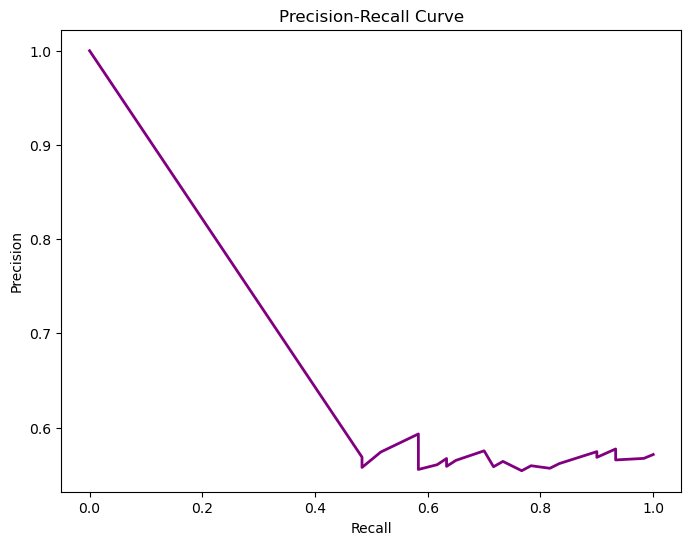

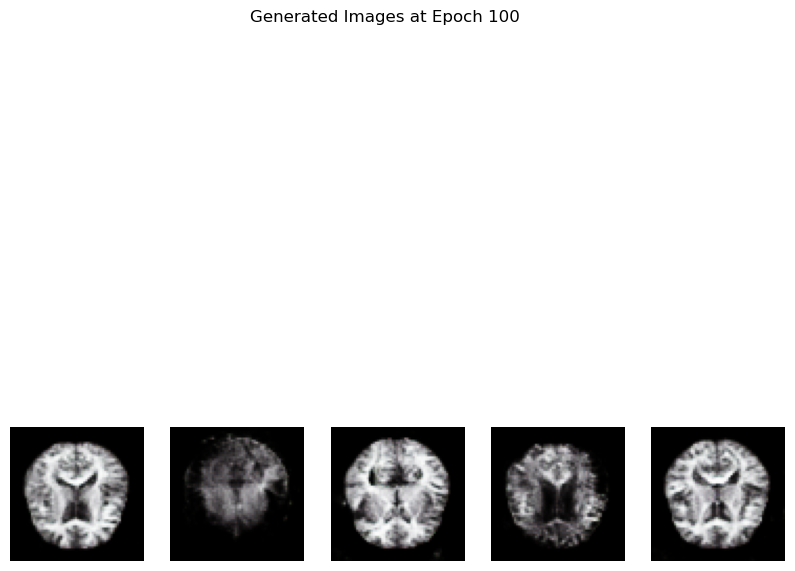

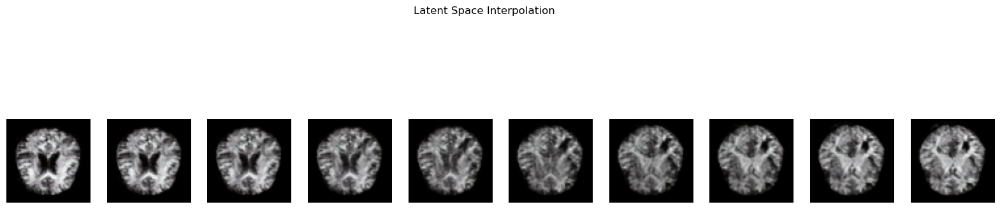

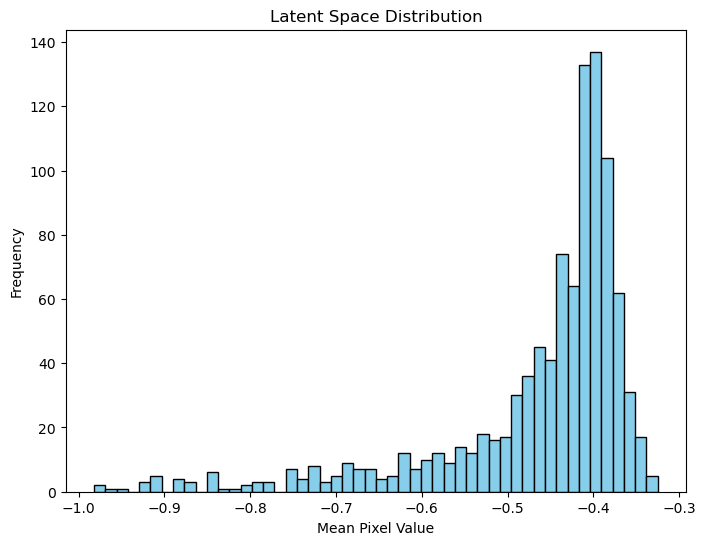

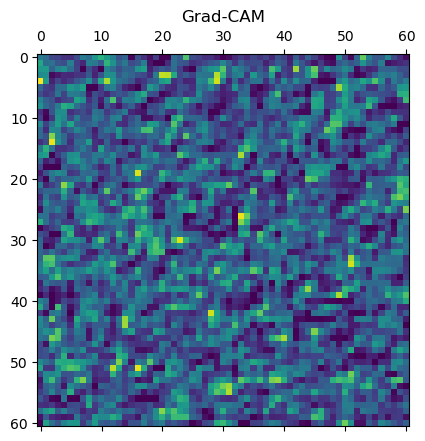

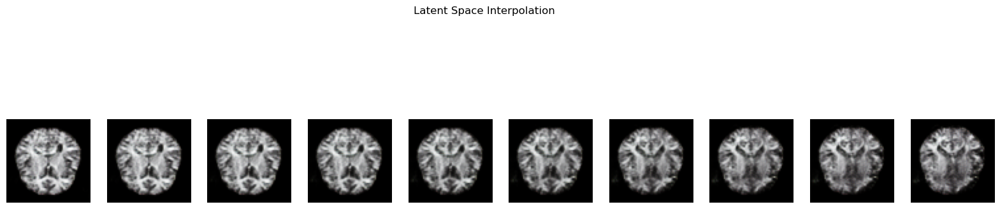

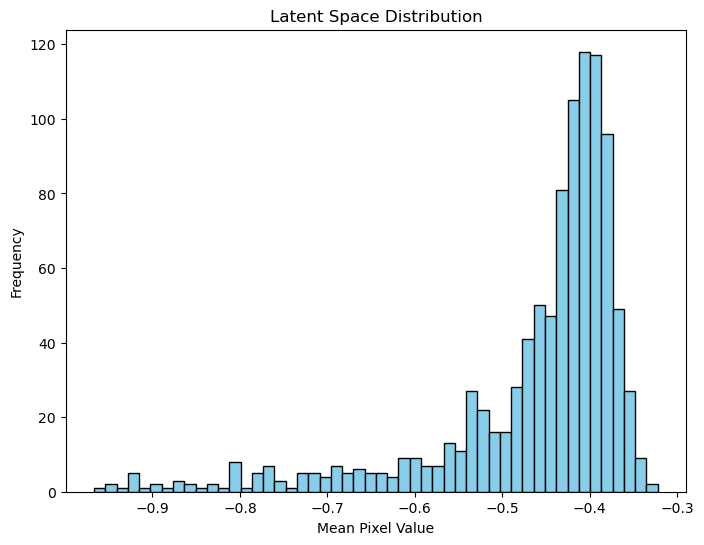

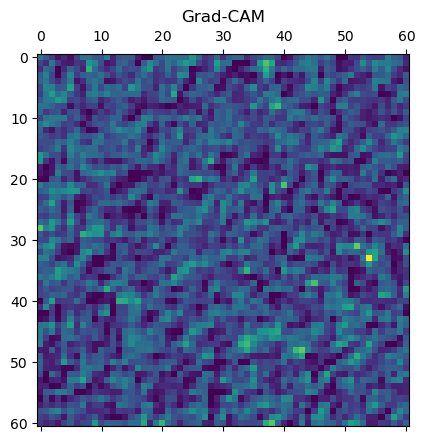

In [ ]:
# Ejecución de las funciones para visualizar las métricas

# 1. Curvas de pérdida y precisión para el modelo CNN
plot_loss_accuracy(history)

# 2. Matriz de confusión para el modelo CNN
plot_confusion_matrix(model, validation_generator)

# 3. Curva ROC y AUC para el modelo CNN
plot_roc_curve(model, validation_generator)

# 4. Curva de precisión-recall para el modelo CNN
plot_precision_recall_curve(model, validation_generator)

# 5. Visualización de imágenes generadas por el GAN
plot_generated_images(generator, epoch=EPOCHS)

# 6. Gráficas adicionales para el GAN
# 6.1 Interpolación latente
plot_latent_interpolation(generator)

# 6.2 Distribución del espacio latente
plot_latent_space_distribution(generator)

# 7. Grad-CAM para una imagen de ejemplo
img_array = np.random.rand(1, 128, 128, 3).astype(np.float32)  # Imagen de ejemplo de tamaño 128x128
plot_grad_cam(model, img_array)


# 10. Interpolación Latente
plot_latent_interpolation(generator)

# 11. Distribución del Espacio Latente
plot_latent_space_distribution(generator)

# 12. Grad-CAM para una imagen de ejemplo
img_array = np.random.rand(1, 128, 128, 3).astype(np.float32)  # Imagen de ejemplo de tamaño 128x128
plot_grad_cam(model, img_array)
